In [ ]:
!pip install mplleaflet
!pip3 install https://github.com/matplotlib/basemap/archive/master.zip

from matplotlib.axes._axes import _log as matplotlib_axes_logger
matplotlib_axes_logger.setLevel('ERROR')
import matplotlib.cm as cm

# Data Loading

In [ ]:
import warnings

warnings.filterwarnings('ignore')

## Importing Data Set

* Loading the data into the pandas data frame is certainly one of the most important steps in Exploratory Data Analysis.

There are six csv files of data on Uber pickups in New York City from April to September 2014. Each file contains data for a particular month and each has the following columns:



*  Date/Time : The date and time of the Uber pickup
*  Lat : The latitude of the Uber pickup
*  Lon : The longitude of the Uber pickup
*  Base : The TLC base company code affiliated with the Uber pickup 











In [ ]:
!curl -O https://transfer.sh/jPMAEq/Dataset.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 23.8M  100 23.8M    0     0  11.3M      0  0:00:02  0:00:02 --:--:-- 11.3M


In [ ]:
!unzip "/content/Dataset.zip" -d "/content/"

Archive:  /content/Dataset.zip
replace /content/Apr.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: /content/Apr.csv        
  inflating: /content/Aug.csv        
  inflating: /content/Jul.csv        
  inflating: /content/Jun.csv        
  inflating: /content/May.csv        
  inflating: /content/Sep.csv        
  inflating: /content/Uber - 2016.csv  


In [ ]:
import pandas as pd

April = pd.read_csv("/content/Apr.csv")
May = pd.read_csv("/content/May.csv")
June = pd.read_csv("/content/Jun.csv")
July = pd.read_csv("/content/Jul.csv")
Aug = pd.read_csv("/content/Aug.csv")
Sep = pd.read_csv("/content/Sep.csv")

In [ ]:
Data = pd.DataFrame()

Files = [April, May, June, July, Aug, Sep]

for file in Files:

  Data = pd.concat([Data, file])

# Data Cleaning

```
Date/Time: The date and time of the Uber pickup

Lat(Latitude): The latitude of the Uber pickup

Lon(Longitude): The longitude of the Uber pickup

Base: The TLC base company code affiliated with the Uber pickup.
```

## Descriptive Statistics

* Descriptive statistics analysis helps to describe the basic features of dataset and obtain a brief summary of the data.

* The describe() method in Pandas library helps us to have a brief summary of the dataset. 

* It automatically calculates basic statistics for all numerical variables excluding NaN (we will come to this part later) values.

```
Pandas head() method is used to return top n (5 by default) rows of a data frame or series. 
```

In [ ]:
Data.head() # Display First 5 Records

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


```
The info() function is used to print a concise summary of a DataFrame. 

This method prints information about a DataFrame including the index dtype and column dtypes, non-null values and memory usage. 
```

In [ ]:
Data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4534327 entries, 0 to 1028135
Data columns (total 4 columns):
 #   Column     Dtype  
---  ------     -----  
 0   Date/Time  object 
 1   Lat        float64
 2   Lon        float64
 3   Base       object 
dtypes: float64(2), object(2)
memory usage: 173.0+ MB


```
Pandas describe() is used to view some basic statistical details like percentile, mean, std etc. of a data frame or a series of numeric values.
```

In [ ]:
Data.describe()

,Lat,Lon
count,4534327.0000,4534327.0000
mean,40.7393,-73.9730
std,0.0399,0.0573
min,39.6569,-74.9290
25%,40.7211,-73.9965
50%,40.7422,-73.9834
75%,40.7610,-73.9653
max,42.1166,-72.0666


```
The dtypes property is used to find the dtypes in the DataFrame. 

This returns a Series with the data type of each column. 

The result's index is the original DataFrame's columns. 

Columns with mixed types are stored with the object dtype.
```

In [ ]:
Data.dtypes

Date/Time     object
Lat          float64
Lon          float64
Base          object
dtype: object

```
The shape property returns a tuple representing the dimensionality of the DataFrame. 

The format of shape would be (rows, columns)
```

In [ ]:
Rows = Data.shape[0] # No of Rows

Columns = Data.shape[1] # No of Columns

print("Rows :", Rows)

print("Columns :", Columns)

Column_Names = Data.columns # Column Names

Rows : 4534327
Columns : 4


## Finding the Column which has only Null Values

```
Heatmaps visualize the data in a 2-dimensional format in the form of colored maps. 

The color maps use hue, saturation, or luminance to achieve color variation to display various details. 

This color variation gives visual cues to the readers about the magnitude of numeric values. 

HeatMaps is about replacing numbers with colors because the human brain understands visuals better than numbers, text, or any written data. 

Heatmaps can describe the density or intensity of variables, visualize patterns, variance, and even anomalies. 

Heatmaps show relationships between variables. 

These variables are plotted on both axes. We look for patterns in the cell by noticing the color change. 
```

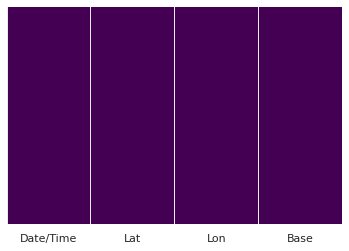

In [ ]:
# To Check missing value

import seaborn as sn

sn.heatmap(Data.isnull(), cbar=False, yticklabels=False, cmap='viridis');

```
Pandas provides functions to check the number of missing values in the dataset. 

Missingno library takes it one step further and provides the distribution of missing values in the dataset by informative visualizations. 

Using the plots of missingno, we are able to see where the missing values are located in each column and if there is a correlation between missing values of different columns. 

Before handling missing values, it is very important to explore them in the dataset. 
```

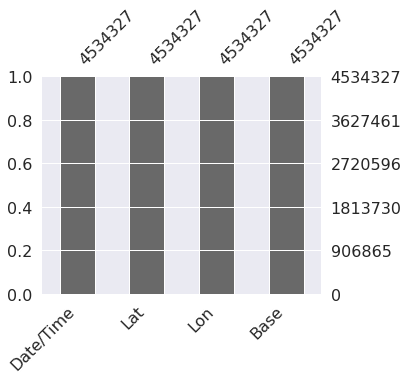

In [ ]:
import missingno as msno

msno.bar(Data, figsize=(5, 4));

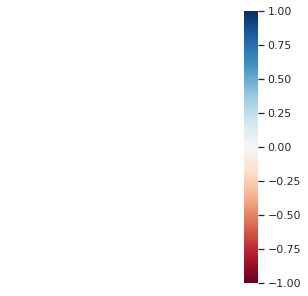

In [ ]:
msno.heatmap(Data, figsize=(5, 5));

In [ ]:
# Find the Number of Rows that has Nan Value in it

Data.isnull().sum()

Date/Time    0
Lat          0
Lon          0
Base         0
dtype: int64

In [ ]:
# Count the No of Non NA cells for each column or row

Data.count()

Date/Time    4534327
Lat          4534327
Lon          4534327
Base         4534327
dtype: int64

In [ ]:
# Find the Number of Rows that has Nan Value in it

Null_Data = Data.isnull().sum()

Null_Columns = [] # List for storing the Null Column Names


for i in range(len(Null_Data)):

  # If the number of Null Values in the Row is equal to the total number of Records, then it means that the whole column contains NUll value in it. 

  if Null_Data[i] == Rows - 1 or Null_Data[i] == Rows:
    
    Null_Columns.append(Column_Names[i])

print(Null_Columns)

[]


```
It's evident that there is no column in the dataset which has only NULL values.
```

## Dropping the Column which has only Null values

In [ ]:
# Delete all NULL Columns which has only NULL values

for i in Null_Columns:

  del Data[i]

In [ ]:
Data

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512
...,...,...,...,...
1028131,9/30/2014 22:57:00,40.7668,-73.9845,B02764
1028132,9/30/2014 22:57:00,40.6911,-74.1773,B02764
1028133,9/30/2014 22:58:00,40.8519,-73.9319,B02764
1028134,9/30/2014 22:58:00,40.7081,-74.0066,B02764


## Finding Rows with any Null Values

In [ ]:
Data.isnull().any()

Date/Time    False
Lat          False
Lon          False
Base         False
dtype: bool

In [ ]:
Data.isnull().sum()

Date/Time    0
Lat          0
Lon          0
Base         0
dtype: int64

In [ ]:
# Display the Rows which has one or more NULL values in it

Data[Data.isnull().any(axis=1)]

,Date/Time,Lat,Lon,Base


## Dropping the rows with Null values

In [ ]:
Data.dropna(inplace=True)

In [ ]:
Data.isnull().any()

Date/Time    False
Lat          False
Lon          False
Base         False
dtype: bool

In [ ]:
print(Data.isnull().sum()) 

Date/Time    0
Lat          0
Lon          0
Base         0
dtype: int64


## Dropping the Duplicate rows

In [ ]:
Data.shape

(4534327, 4)

In [ ]:
# Check if there is any Duplicate Rows

duplicate = Data[Data.duplicated()]

print("Number of Duplicate rows: ", duplicate.shape)

Number of Duplicate rows:  (82581, 4)


In [ ]:
Data.count()  

Date/Time    4534327
Lat          4534327
Lon          4534327
Base         4534327
dtype: int64

In [ ]:
# Drop all the Duplicate Rows

Data = Data.drop_duplicates()

In [ ]:
Data.count()

Date/Time    4451746
Lat          4451746
Lon          4451746
Base         4451746
dtype: int64

In [ ]:
len(Data)

4451746

In [ ]:
Data.describe(include=["O"])

,Date/Time,Base
count,4451746,4451746
unique,260093,5
top,4/7/2014 20:21:00,B02617
freq,97,1417983


In [ ]:
Data['Date/Time'] =  pd.to_datetime(Data['Date/Time'])

In [ ]:
from datetime import datetime as dt

Data["Year"] = Data['Date/Time'].dt.year

Data["Day"]=Data['Date/Time'].dt.day

Data["Month"]=Data['Date/Time'].dt.month

Data["Hour"]=Data['Date/Time'].dt.hour

Data["Minute"]=Data['Date/Time'].dt.minute

Data["Second"]=Data['Date/Time'].dt.second

Data.head()

,Date/Time,Lat,Lon,Base,Year,Day,Month,Hour,Minute,Second
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,2014,1,4,0,11,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,2014,1,4,0,17,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,2014,1,4,0,21,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,2014,1,4,0,28,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,2014,1,4,0,33,0


In [ ]:
# Weekdays as a Tuple

WeekDays = ["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"]

Data["Week_Day_Int"] = Data['Date/Time'].dt.weekday

Data["Week_Day_String"] = Data['Date/Time'].dt.day_name()

# Exploratory Data Analysis 

## Trip by Month

* Exploring the pickups per month and find out if there was an Increase or a Decrease in the Total Journeys

In [ ]:
# Find the Number of Months

Data.Month.unique().tolist()

[4, 5, 6, 7, 8, 9]

In [ ]:
Month = Data.groupby("Month").count()

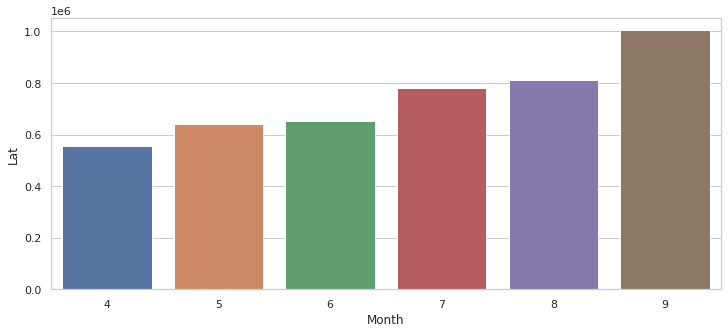

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12,5))

sns.set(style="whitegrid")

sns.barplot(x = Month.index, y = Month.Lat);



*   From the above graph, we can see that there is a steady increase in the number of pickups every month
*  A slightly larger increase is noted from August to September (Total Journey Ratio = 1 * 10^6)


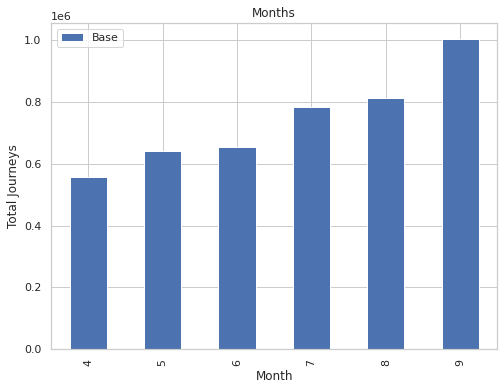

In [ ]:
Monthly_uber_rides = Data.pivot_table(index=['Month'], values='Base', aggfunc='count')

Monthly_uber_rides.plot(kind='bar',figsize=(8,6))

plt.ylabel('Total Journeys')

plt.title('Months');

* We shall see that there is an increase every month of hailed rides ( Total Journeys Ratio = 1*10^6 )

## Trip by Week Day

* Finding out which days had more Journeys than other days over the 6 months

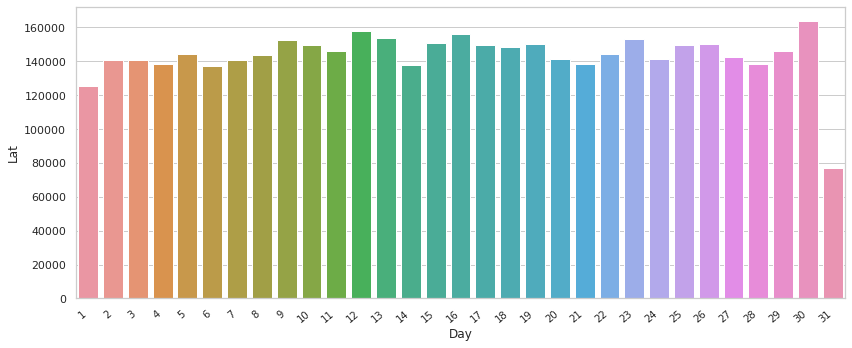

In [ ]:
Day = Data.groupby("Day").count()

plt.figure(figsize=(12,5))

sns.set(style="whitegrid")

ax = sns.barplot(x = Day.index, y = Day.Lat)

ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right",fontsize=10)

plt.tight_layout()

plt.show()

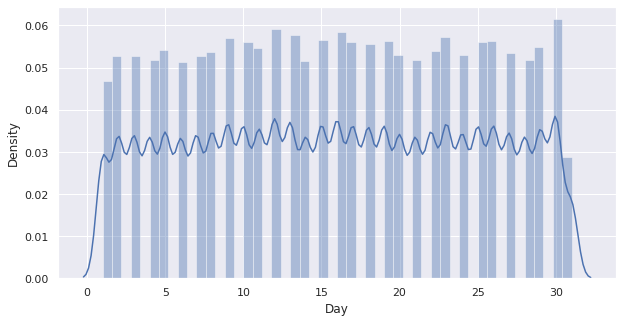

In [ ]:
sns.set(rc={'figure.figsize':(10, 5)})

sns.distplot(Data["Day"]);

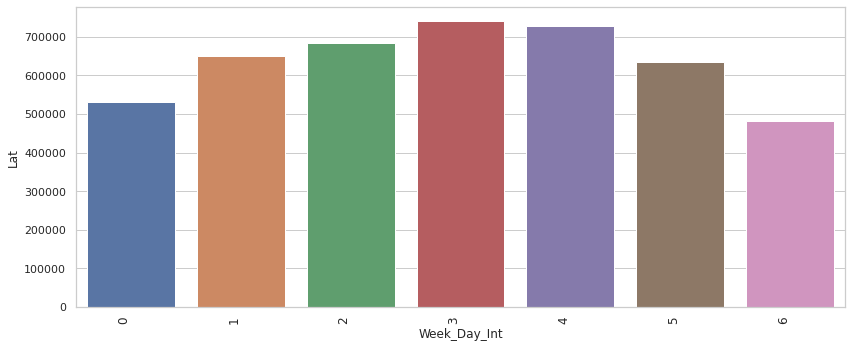

In [ ]:
Week_Day = Data.groupby("Week_Day_Int").count()

plt.figure(figsize=(12,5))

sns.set(style="whitegrid")

ax = sns.barplot(x = Week_Day.index, y = Week_Day.Lat)

ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha="right",fontsize=12)

plt.tight_layout()

plt.show()

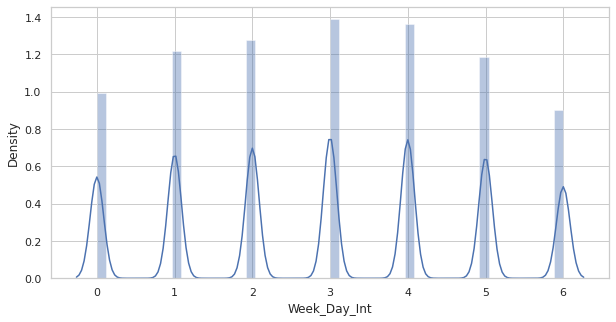

In [ ]:
sns.distplot(Data["Week_Day_Int"])

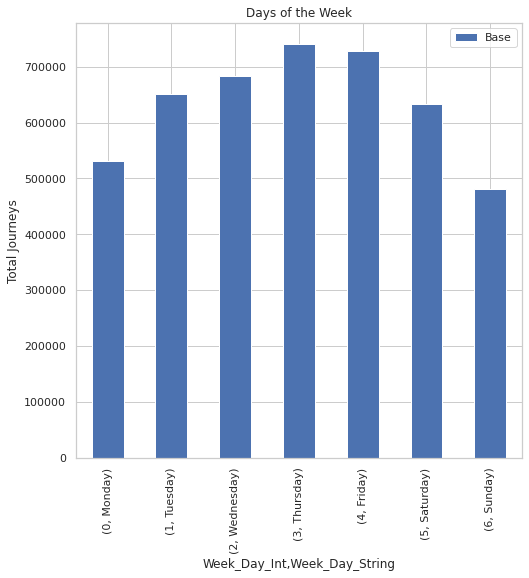

In [ ]:
Daily_uber_rides = Data.pivot_table(index=['Week_Day_Int','Week_Day_String'], values='Base', aggfunc='count')

Daily_uber_rides.plot(kind='bar',figsize=(8, 8))

plt.ylabel('Total Journeys')

plt.title('Days of the Week');

* Interestingly, there were more rides on Thursday and Friday is closely followed. 
* Its also interesting that there were more rides on even wednesday and tuesday than on Saturdays

In [ ]:
Daily_uber_rides_month = Data.groupby(['Month','Week_Day_Int','Week_Day_String'])['Base'].count()

Daily_uber_rides_month = Daily_uber_rides_month.reset_index()

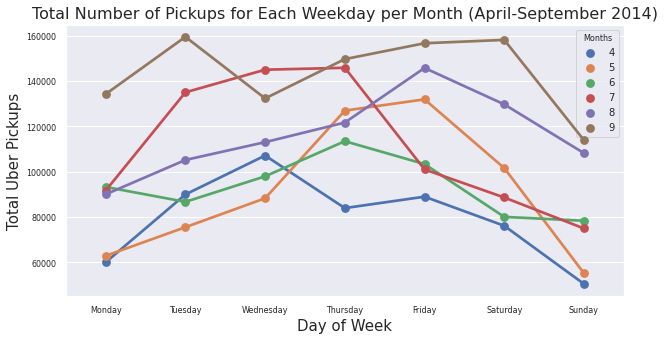

In [ ]:
sns.set_style('darkgrid')

ax = sns.pointplot(x="Week_Day_String", y="Base", hue="Month", data = Daily_uber_rides_month)

handles, labels = ax.get_legend_handles_labels()

ax.set_xlabel('Day of Week', fontsize = 15) 

ax.set_ylabel('Total Uber Pickups', fontsize = 15)

ax.set_title('Total Number of Pickups for Each Weekday per Month (April-September 2014)', fontsize=16)

ax.tick_params(labelsize = 8)

ax.legend(handles,labels,loc=0, title="Months", prop={'size':10})

ax.get_legend().get_title().set_fontsize('8')

plt.show()

## Trip by Hour

In [ ]:
Hour = Data.groupby("Hour").count()

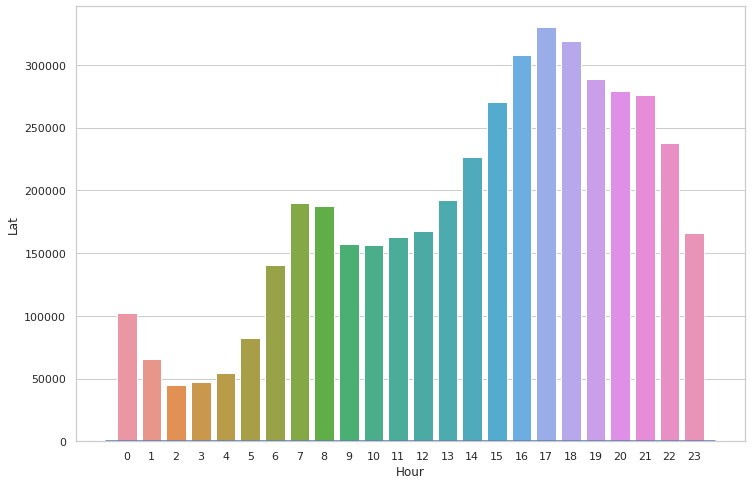

<Figure size 864x432 with 0 Axes>

In [ ]:
sns.set(style = "whitegrid")

plt.figure(figsize=(12,8))

sns.barplot( x = Hour.index, y = Hour.Lat);

sns.distplot(Data["Hour"]);

fig = plt.figure(figsize=(12,6));

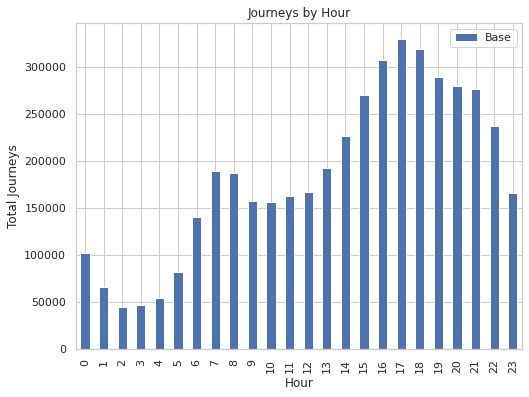

In [ ]:
Uber_hour = Data.pivot_table(index=['Hour'], values='Base', aggfunc='count')

Uber_hour.plot(kind='bar', figsize=(8,6))

plt.ylabel('Total Journeys')

plt.title('Journeys by Hour');

In [ ]:
## Groupby operation

Hourly_ride_data = Data.groupby(['Month','Week_Day_Int','Hour','Week_Day_String'])['Base'].count()

## Reset index

Hourly_ride_data = Hourly_ride_data.reset_index()

## Rename column

Hourly_ride_data = Hourly_ride_data.rename(columns = {'Base':'RideCount'})

## Ocular analysis

Hourly_ride_data.head()

,Month,Week_Day_Int,Hour,Week_Day_String,RideCount
0,4,0,0,Monday,509
1,4,0,1,Monday,259
2,4,0,2,Monday,237
3,4,0,3,Monday,562
4,4,0,4,Monday,1004


In [ ]:
## Groupby Operation

Weekday_hourly_avg = Hourly_ride_data.groupby(['Week_Day_String','Hour'])['RideCount'].mean()

## Reset index

Weekday_hourly_avg = Weekday_hourly_avg.reset_index()

## Rename column

Weekday_hourly_avg = Weekday_hourly_avg.rename(columns = {'RideCount':'AverageRides'})

## Sort by categorical index

Weekday_hourly_avg = Weekday_hourly_avg.sort_index()

## Ocular analysis

Weekday_hourly_avg.head()

,Week_Day_String,Hour,AverageRides
0,Friday,0,2241.1667
1,Friday,1,1333.6667
2,Friday,2,872.0000
3,Friday,3,1131.3333
4,Friday,4,1440.1667


In [ ]:
Weekday_hourly_avg.Week_Day_String.value_counts()

Monday       24
Tuesday      24
Thursday     24
Friday       24
Wednesday    24
Saturday     24
Sunday       24
Name: Week_Day_String, dtype: int64

In [ ]:
# Convert AverageRides column from float to int

Weekday_hourly_avg['AverageRides'] = Weekday_hourly_avg['AverageRides'].astype('int')
Weekday_hourly_avg['AverageRides'].dtypes

dtype('int64')

In [ ]:
Weekday_hourly_avg.head()

,Week_Day_String,Hour,AverageRides
0,Friday,0,2241
1,Friday,1,1333
2,Friday,2,872
3,Friday,3,1131
4,Friday,4,1440


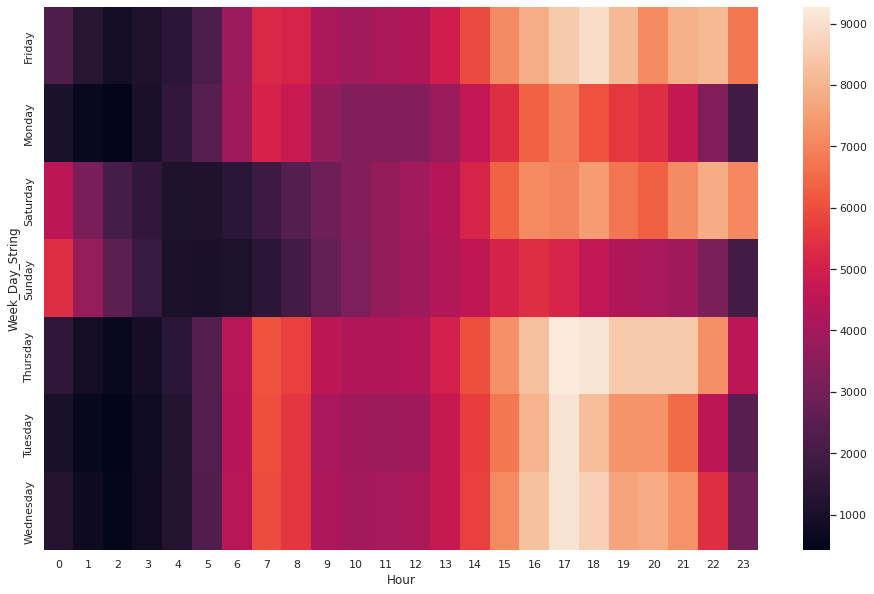

In [ ]:
Heatmap = pd.pivot_table(Weekday_hourly_avg, values='AverageRides', index=['Week_Day_String'], columns='Hour')

plt.figure(figsize=(16,10));

sns.heatmap(Heatmap);

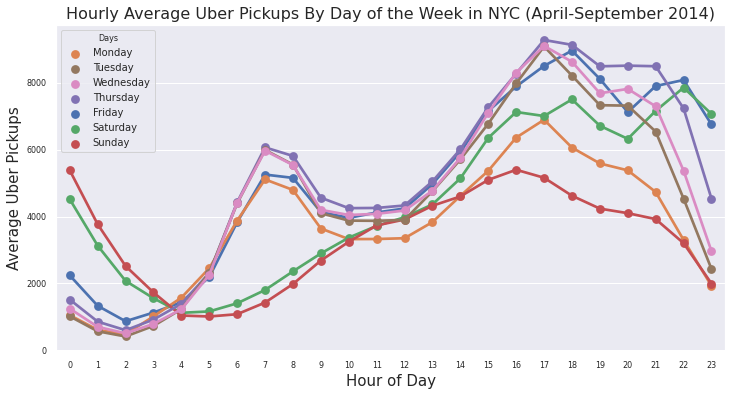

In [ ]:
fig = plt.figure(figsize=(12,6))

sns.set_style('darkgrid')

ax = sns.pointplot(x = "Hour", y = "AverageRides", hue = "Week_Day_String", data = Weekday_hourly_avg)

handles, labels = ax.get_legend_handles_labels()

handles = [handles[1], handles[5], handles[6], handles[4], handles[0], handles[2], handles[3]]

labels = [labels[1], labels[5], labels[6], labels[4], labels[0], labels[2], labels[3]]

ax.set_xlabel('Hour of Day', fontsize = 15)

ax.set_ylabel('Average Uber Pickups', fontsize = 15)

ax.set_title('Hourly Average Uber Pickups By Day of the Week in NYC (April-September 2014)', fontsize=16)

ax.tick_params(labelsize = 8)

ax.legend(handles,labels,loc=0, title="Days", prop={'size':10})

ax.get_legend().get_title().set_fontsize('8')

plt.show()

## Trips by Base

In [ ]:
Data.Base.value_counts()

B02617    1417983
B02598    1379578
B02682    1198901
B02764     254931
B02512     200353
Name: Base, dtype: int64

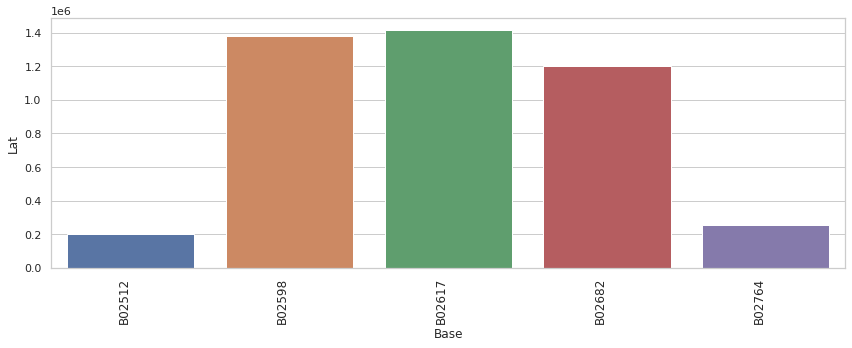

In [ ]:
Base = Data.groupby("Base").count()

plt.figure(figsize=(12,5))

sns.set(style="whitegrid")

ax = sns.barplot(x = Base.index, y = Base.Lat)

ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha="right",fontsize=12)

plt.tight_layout()

plt.show()

In [ ]:
Base = {"Base": {'B02617':'Weiter', 'B02598':'Hinter','B02682':'Schmecken','B02764':'Danach-NY','B02512':'Unter'}}

Uber_2014_Bases = Data.copy()

Uber_2014_Bases.replace(Base, inplace=True)

Uber_2014_Bases.head()

,Date/Time,Lat,Lon,Base,Year,Day,Month,Hour,Minute,Second,Week_Day_Int,Week_Day_String
0,2014-04-01 00:11:00,40.7690,-73.9549,Unter,2014,1,4,0,11,0,1,Tuesday
1,2014-04-01 00:17:00,40.7267,-74.0345,Unter,2014,1,4,0,17,0,1,Tuesday
2,2014-04-01 00:21:00,40.7316,-73.9873,Unter,2014,1,4,0,21,0,1,Tuesday
3,2014-04-01 00:28:00,40.7588,-73.9776,Unter,2014,1,4,0,28,0,1,Tuesday
4,2014-04-01 00:33:00,40.7594,-73.9722,Unter,2014,1,4,0,33,0,1,Tuesday


In [ ]:
Uber_2014_Bases.shape

(4451746, 12)

In [ ]:
Uber_2014_Bases1  = Uber_2014_Bases.iloc[:2551746,:]

In [ ]:
import plotly.express as px

fig = px.histogram(Uber_2014_Bases1, x = "Base", title='Pickups Per Base', labels={'count':'No of Pickups'})

fig.show()

## Heatmap of Day & Hour

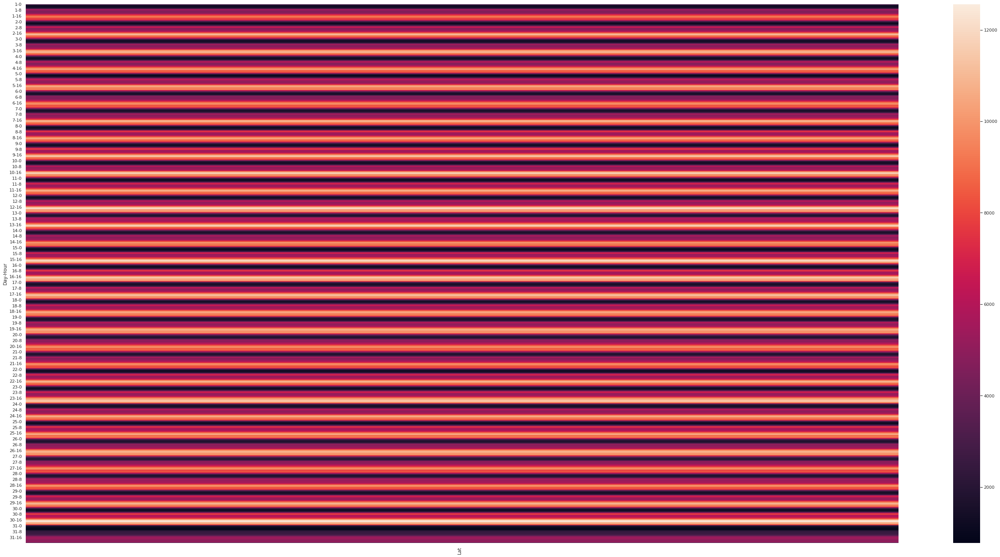

In [ ]:
Day_Hour = Data.groupby(["Day","Hour"])[["Lat"]].count()

plt.figure(figsize=(40,20))

sns.set(style="whitegrid")

ax = sns.heatmap(Day_Hour)

ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha="right",fontsize=12)

plt.tight_layout()

plt.show()

## Correlation of Hours and Week Days

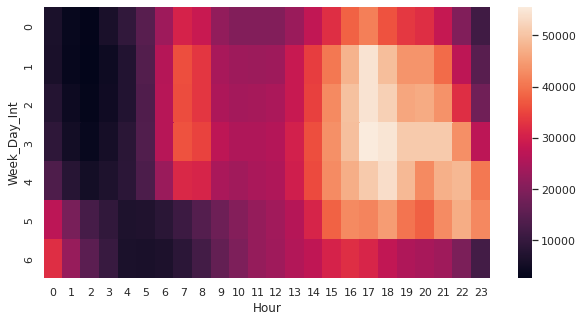

In [ ]:
df = Data.groupby(["Week_Day_Int","Hour"]).apply(lambda x: len(x))

df = df.unstack()

sns.heatmap(df,annot=False);

## Density of Uber trips

* Density of Uber trips according to the regions of the New Your city.

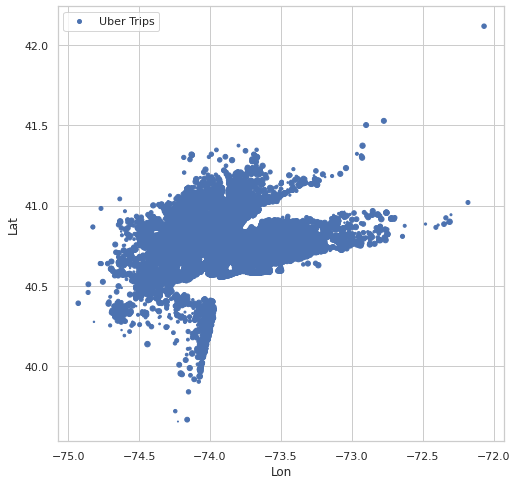

In [ ]:
Data.plot(kind='scatter', x = 'Lon', y = 'Lat', s = Data['Day'], label='Uber Trips', figsize=(8, 8));

## Monthly Geographical Distribution

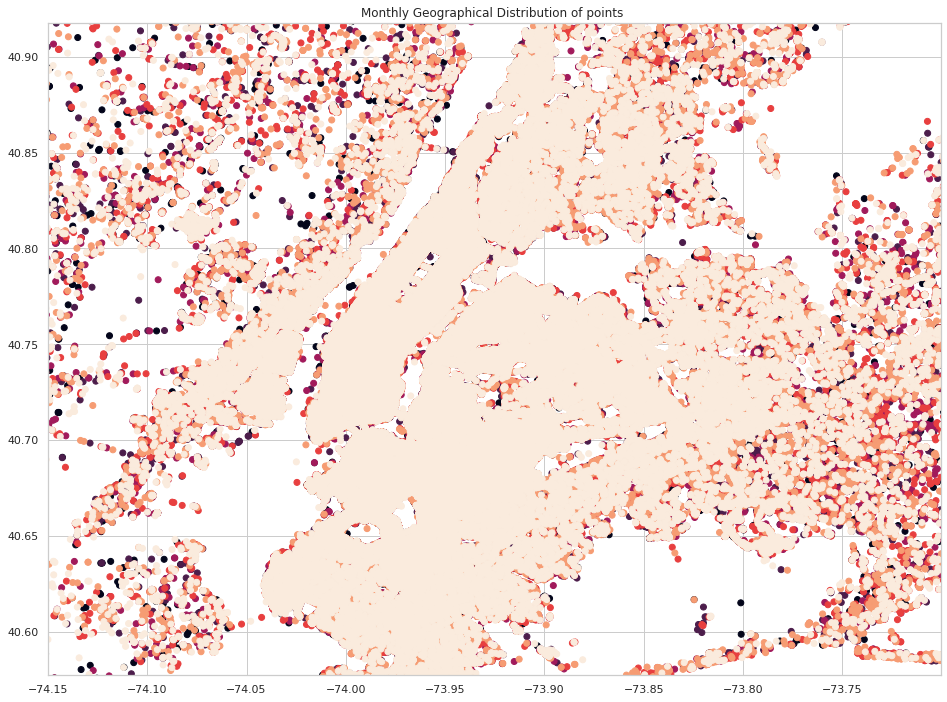

In [ ]:
min_lat = 40.5774
max_lat = 40.9176
min_long = -74.15
max_long = -73.7004

plt.figure(figsize=(16,12))

plt.title("Monthly Geographical Distribution of points ")

plt.scatter(x=Data.Lon,y=Data.Lat,c=Data.Month.values)

plt.xlim(min_long,max_long)

plt.ylim(min_lat,max_lat)

plt.show()

## Daily Geographical Distribution

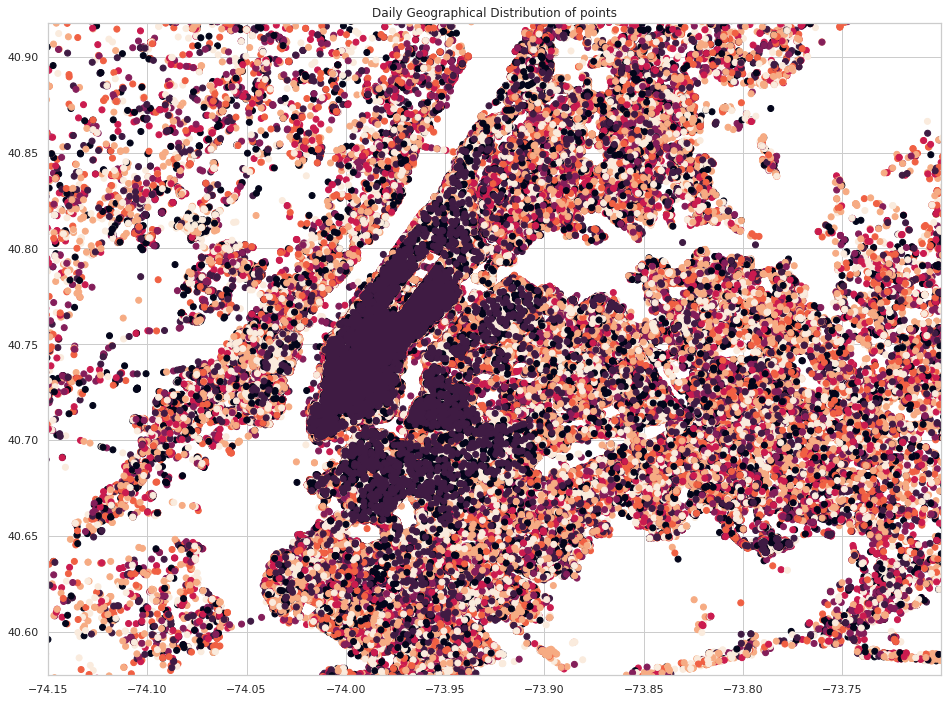

In [ ]:
min_lat = 40.5774
max_lat = 40.9176
min_long = -74.15
max_long = -73.7004

plt.figure(figsize=(16,12))

plt.title("Daily Geographical Distribution of points")

plt.scatter(x=Data.Lon,y=Data.Lat,c=Data.Week_Day_Int.values)

plt.xlim(min_long,max_long)

plt.ylim(min_lat,max_lat)

plt.show()

## Heat Map of Total Pickups

* Heat Map of Total Pickups over the 6 Months

* Lets create a heatmap of the pickups to try and visualize the distribution of pickups over NYC over those months to view the areas with alot of pickups, and vice versa. 

* We’ll be using the Basemap Package. 

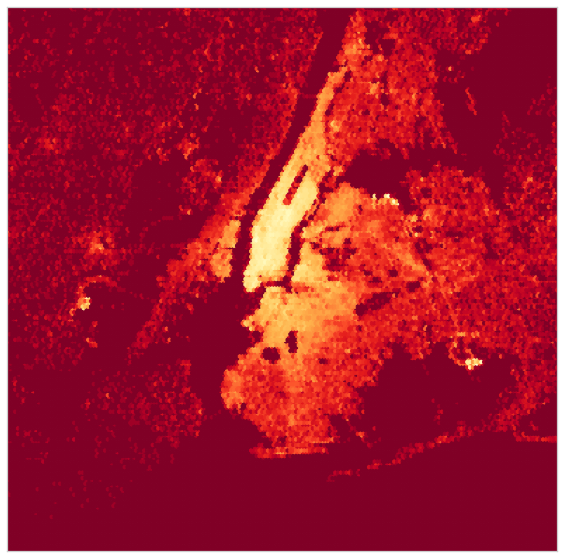

In [ ]:
from mpl_toolkits.basemap import Basemap

west, south, east, north = -74.26, 40.50, -73.70, 40.92

fig = plt.figure(figsize=(14,10))

ax = fig.add_subplot(111)

m = Basemap(projection='merc', llcrnrlat = south, urcrnrlat = north, llcrnrlon = west, urcrnrlon = east, lat_ts = south, resolution = 'i')

x, y = m(Data['Lon'].values, Data['Lat'].values)

m.hexbin(x, y, gridsize=1000, bins='log', cmap=cm.YlOrRd_r);

## Highly Clustered/Hotspot Areas

* While it can be useful to look at the raw data set of our heatmap and gain intuition, looking at snap shots doesn’t give us enough information to make good conclusions, and plotting hours of individual pick-ups just makes a mess. 

* We want actionable conclusions from this data set, so we’ll need to be able to make quantitative comparisons between different regions in the city and we may not use the Bases column since they cover huge areas. 

* We’ll implement the DBSCAN clustering method from scikit-learn instead of structured spatial binning. 

* The K-Means algorithm is likely the most common clustering algorithm. 

* But for spatial data, the DBSCAN algorithm is far superior in this kind of scenario where you are also using geographical data.

* The DBSCAN algorithm will group points together that meet a specified density metric. 

* Basically, we’ll define a maximum distance to make two individual points count as neighbors, as well as a minimum number of neighbors for a group of points to qualify as a cluster. 

* The algorithm will sort the points into groups which meet the criteria and discard all of the outliers.

* Once DBSCAN has identified all applicable clusters, we can easily calculate the centroid using the MultiPoint class from Shapely and plot the results.

* This allows us to precisely identify locations which experience a high volume of pick-ups during a specified time frame. 

* By using the total number of pickups in an individual cluster as a metric for coloring the hot spot locations, we can visualize the intensity of a given hotspot in addition to it’s centroid.

* First, we’ll write a function which runs the clustering algorithm and returns the “hot spots.” We’ll get the coordinates of the centroid and the number of pickups in each cluster.

In [ ]:
from sklearn.cluster import DBSCAN
from geopy.distance import great_circle
from shapely.geometry import MultiPoint
import numpy as np

def Hot_Spots(max_distance,min_cars,ride_data):
    
    # Get coordinates from ride data

    coords = ride_data[['Lat', 'Lon']].to_numpy()
    
    # Calculate epsilon parameter using the User Defined distance

    kms_per_radian = 6371.0088

    # The epsilon parameter is the max distance that points can be from each other to be considered a cluster.

    epsilon = max_distance / kms_per_radian
    
    ## Perform clustering

    db = DBSCAN(eps=epsilon, min_samples=min_cars, algorithm='ball_tree', metric='haversine').fit(np.radians(coords))
    
    ## Group the Clusters

    cluster_labels = db.labels_

    num_clusters = len(set(cluster_labels))

    clusters = pd.Series([coords[cluster_labels == n] for n in range(num_clusters)])
    
    ## Report

    print('Number of clusters: {}'.format(num_clusters))
    
    ## Initialize lists for hot spots

    lat = []

    lon = []

    num_members = []
    
    ## Loop through Clusters and get Centroids, Number of Members

    for i in range(len(clusters)):

        if clusters[i].any(): ## Filter Empty clusters

            lat.append(MultiPoint(clusters[i]).centroid.x) ## Get centroid and magnitude of cluster

            lon.append(MultiPoint(clusters[i]).centroid.y)

            num_members.append(len(clusters[i]))
            
    hot_spots = [lon,lat,num_members]
    
    return hot_spots

**Question :** Where are the locations which experience more than 25 pickups that occur within 50 meters of each other after 4:00 PM on August 14, 2014?

In [ ]:
## Get ride data

Ride_data = Uber_2014_Bases.loc[(Uber_2014_Bases['Day']== 21) & (Uber_2014_Bases['Hour'] > 15)]

Max_distance = 0.05 # Maximum distance between two cluster members in kilometers

Min_pickups = 25 # Minimum number of cluster members

Hot_spots = Hot_Spots(Max_distance , Min_pickups, Ride_data) ## Call the get_hot_spots function

Number of clusters: 171


* From the data, there are 171 cluster all around NYC meeting the criteria.

* To visualize this, we’ll use a scatter plot so that we can set the marker color using the cluster size as a metric. 

* If we use a logarithmic scale on the color map, then there is better visual distinction near the lower bound. 

* If we use a linear color scale, then values near the lower bound will all appear as a similar color. 

In [ ]:
import mplleaflet

import matplotlib.pyplot as plt

import numpy as np

fig = plt.figure(figsize=(14,8))

ax = fig.add_subplot(111)

color_scale = np.log(Hot_spots[2])

plt.scatter(Hot_spots[0], Hot_spots[1], s = 80, c = color_scale, cmap = cm.cool)

# plt.show() 

mplleaflet.display() 

* The map above shows areas experiencing more than 25 pickups that occur within 50 meters of each other after 4:00 PM on August 14, 2014.

# Network Analysis

In [ ]:
data = pd.read_csv("/content/Uber - 2016.csv")

data = data.drop(data.index[len(data)-1])

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1155 entries, 0 to 1154
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   START_DATE*  1155 non-null   object 
 1   END_DATE*    1155 non-null   object 
 2   CATEGORY*    1155 non-null   object 
 3   START*       1155 non-null   object 
 4   STOP*        1155 non-null   object 
 5   MILES*       1155 non-null   float64
 6   PURPOSE*     653 non-null    object 
dtypes: float64(1), object(6)
memory usage: 72.2+ KB


In [ ]:
# Replacing missing values with PURPOSE* equals to "other"

data['PURPOSE*'].replace(np.nan, 'Other', inplace=True)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1155 entries, 0 to 1154
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   START_DATE*  1155 non-null   object 
 1   END_DATE*    1155 non-null   object 
 2   CATEGORY*    1155 non-null   object 
 3   START*       1155 non-null   object 
 4   STOP*        1155 non-null   object 
 5   MILES*       1155 non-null   float64
 6   PURPOSE*     1155 non-null   object 
dtypes: float64(1), object(6)
memory usage: 72.2+ KB


In [ ]:
data['PURPOSE*'].value_counts()

Other              502
Meeting            187
Meal/Entertain     160
Errand/Supplies    128
Customer Visit     101
Temporary Site      50
Between Offices     18
Moving               4
Airport/Travel       3
Charity ($)          1
Commute              1
Name: PURPOSE*, dtype: int64

## Purpose vs Rides

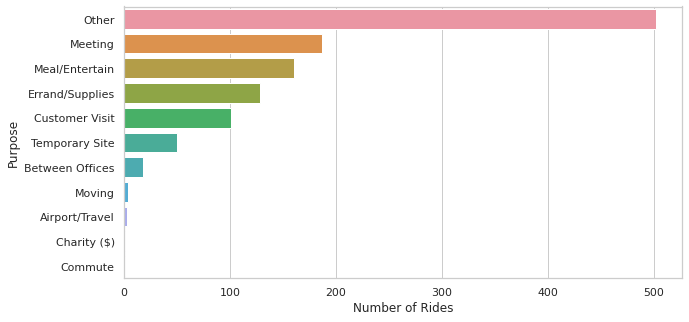

In [ ]:
# Creating a dataframe containing type of purpose and the number of rides associated with each purpose

Ride_count = data['PURPOSE*'].value_counts().tolist()

Ride_purpose= data['PURPOSE*'].value_counts().index.tolist()

Ride_info = list(zip(Ride_purpose, Ride_count))

Ride_info = pd.DataFrame(Ride_info, columns=['PURPOSE','COUNT'])

ax = sns.barplot(x='COUNT', y='PURPOSE', data = Ride_info, order = Ride_info['PURPOSE'].tolist())

ax.set(xlabel='Number of Rides', ylabel='Purpose')

plt.show()

## Purpose vs Miles

In [ ]:
data['CATEGORY*'].value_counts()

Business    1078
Personal      77
Name: CATEGORY*, dtype: int64

In [ ]:
Ride_summary = data.groupby('PURPOSE*').mean()

Ride_summary

,MILES*
PURPOSE*,
Airport/Travel,5.5000
Between Offices,10.9444
Charity ($),15.1000
Commute,180.2000
Customer Visit,20.6881
Errand/Supplies,3.9688
Meal/Entertain,5.6981
Meeting,15.2476
Moving,4.5500


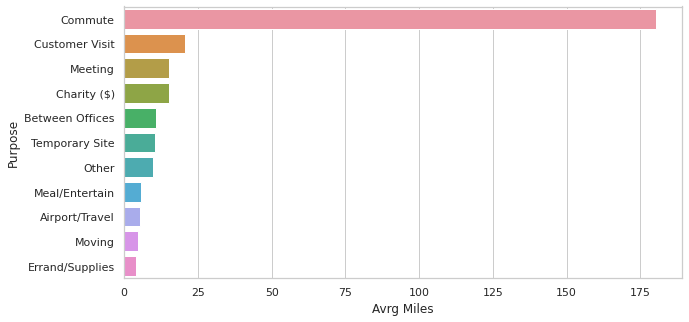

In [ ]:
Ride_summary['PURPOSE*'] = Ride_summary.index.tolist()

ax = sns.barplot(x = 'MILES*', y = 'PURPOSE*', data = Ride_summary, order = Ride_summary.sort_values('MILES*',ascending=False)['PURPOSE*'].tolist())

ax.set(xlabel='Avrg Miles', ylabel='Purpose')

plt.show()

In [ ]:
start_list = [info.split(' ') for info in data['START_DATE*'].tolist()]
stop_list = [info.split(' ') for info in data['END_DATE*'].tolist()]

start_df  = pd.DataFrame(start_list,columns=['Start_Date','Start_Time'])
end_df  = pd.DataFrame(stop_list,columns=['End_Date','End_Time'])

sub_data = data[['CATEGORY*','START*','STOP*','MILES*','PURPOSE*']]
start_end_info = pd.concat([start_df,end_df,],axis=1)

Rides = pd.concat([start_end_info,sub_data],axis=1)
Rides.head(5)

,Start_Date,Start_Time,End_Date,End_Time,CATEGORY*,START*,STOP*,MILES*,PURPOSE*
0,1/1/2016,21:11,1/1/2016,21:17,Business,Fort Pierce,Fort Pierce,5.1000,Meal/Entertain
1,1/2/2016,1:25,1/2/2016,1:37,Business,Fort Pierce,Fort Pierce,5.0000,Other
2,1/2/2016,20:25,1/2/2016,20:38,Business,Fort Pierce,Fort Pierce,4.8000,Errand/Supplies
3,1/5/2016,17:31,1/5/2016,17:45,Business,Fort Pierce,Fort Pierce,4.7000,Meeting
4,1/6/2016,14:42,1/6/2016,15:49,Business,Fort Pierce,West Palm Beach,63.7000,Customer Visit


## Total Miles Per Month

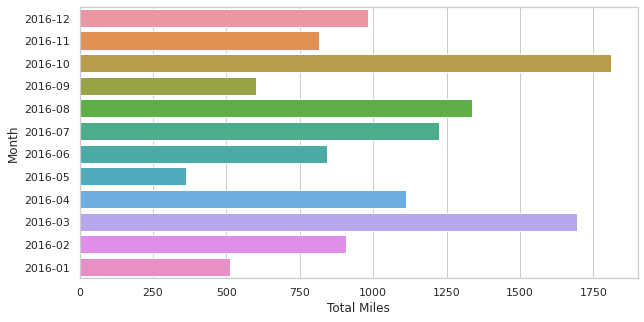

In [ ]:
rides_per_month = Rides.groupby('Start_Date').sum()

rides_per_month['Month']=pd.to_datetime(rides_per_month.index.tolist()) 

rides_per_month['Month']= rides_per_month['Month'].dt.to_period("M") # Grouping dates by month

rides_per_month= rides_per_month.sort_values(by= 'Month',ascending=True)

total_miles_per_month= rides_per_month.groupby('Month').sum()

total_miles_per_month['MONTH']=total_miles_per_month.index.tolist()

total_miles_per_month['MONTH']=total_miles_per_month['MONTH'].astype(str) # Converting the Time Stamp format to string

ax = sns.barplot(x='MILES*',y='MONTH',data=total_miles_per_month,order=total_miles_per_month.sort_values('MONTH',ascending=False)['MONTH'].tolist())

ax.set(xlabel='Total Miles', ylabel='Month')

plt.show()

## Location Visited




*   Graph is a collection of nodes along with identified pairs of nodes.
*   In NetworkX, nodes can be any hashable object like a text string, an image, an XML object, another Graph or a customizable node object


*   nx.from_pandas_edgelist() returns a graph from Pandas Framework which contain an Edge List
*   nx.draw_circular() draws a graph G with a circular layour

Therefore, the graph below depicts the starting and ending points that has been recorded in our dataset.






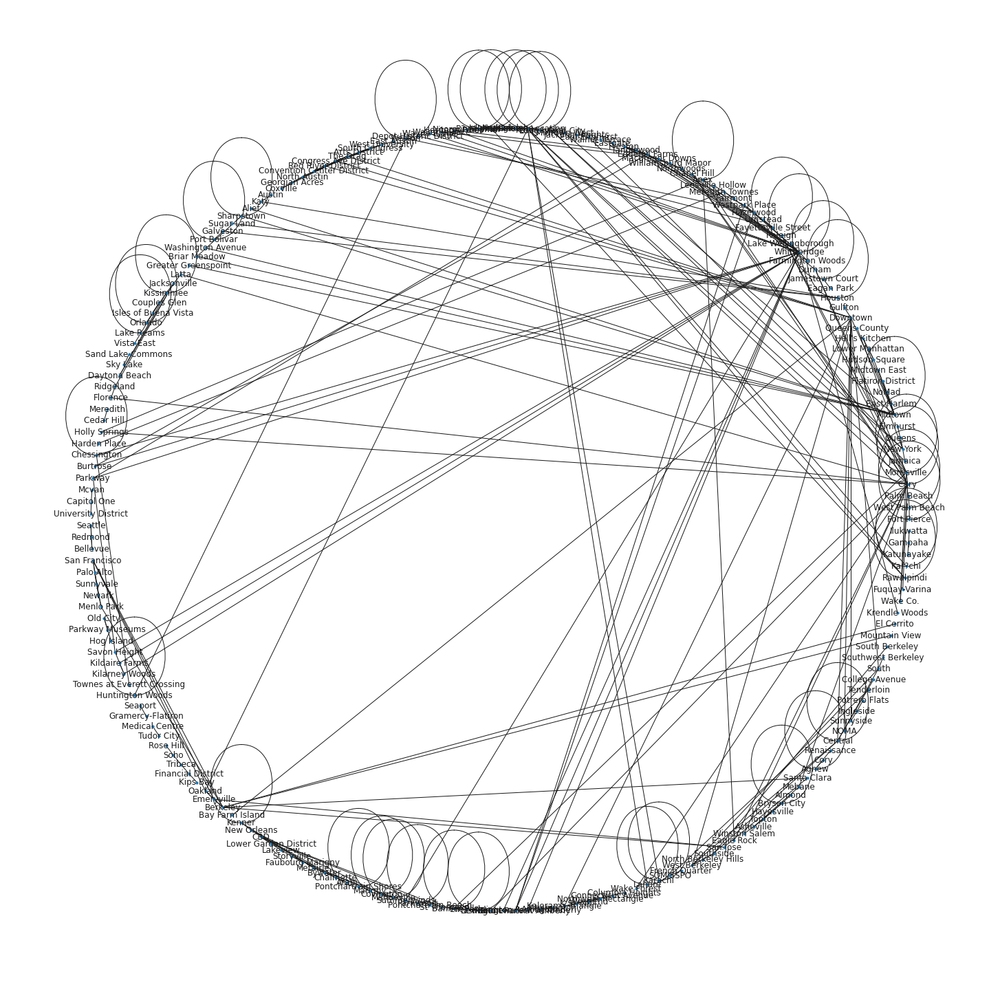

In [ ]:
import networkx as nx
import pandas as pd

g = nx.Graph()

g = nx.from_pandas_edgelist(Rides, source='START*', target='STOP*', 
                           edge_attr=['Start_Date','Start_Time','End_Date','End_Time','CATEGORY*','MILES*','PURPOSE*'])

plt.figure(figsize=(20, 20)) 

nx.draw_circular(g, with_labels = True, node_size = 10)

plt.show()

## Locations Visited atleast 5 times

In [ ]:
# Identifying which location is being visited more frequently (whether for pickup or dropoff)

location=[]

degree=[]

for node in g:

    location.append(node)
    degree.append(g.degree(node))

degree_dist_list = list (zip(location, degree))

degree_dist = pd.DataFrame(degree_dist_list, columns=['Location','Degree'])

degree_dist.sort_values(by = 'Degree', ascending = False )

,Location,Degree
25,Whitebridge,26
3,Cary,18
50,Unknown Location,15
9,Midtown,14
18,Downtown,12
...,...,...
89,Vista East,1
86,Isles of Buena Vista,1
81,Greater Greenspoint,1
79,Washington Avenue,1


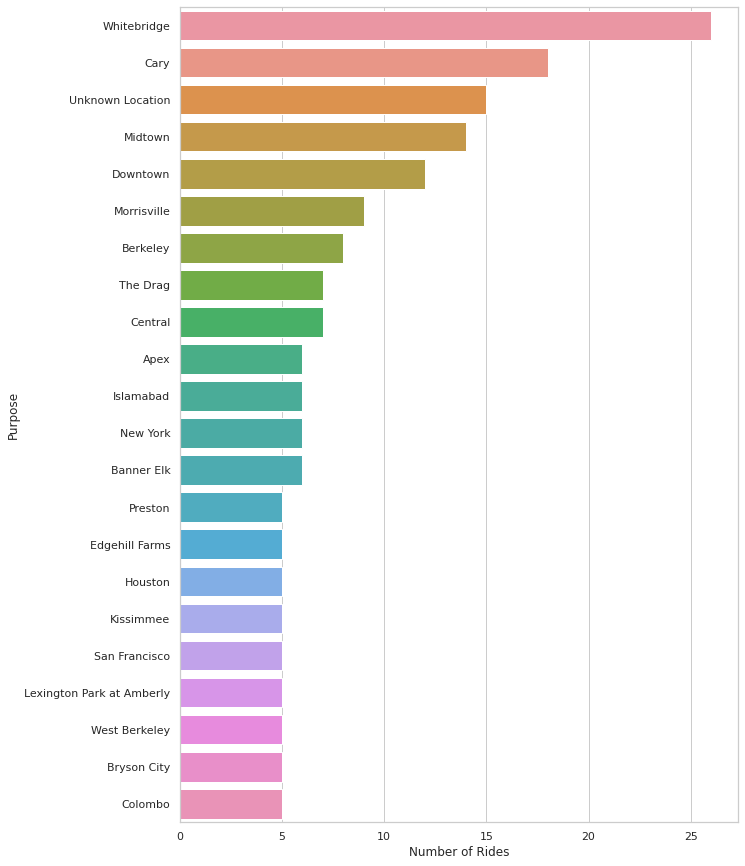

In [ ]:
plt.figure(figsize=(10,15));

ax = sns.barplot(x = 'Degree', y = 'Location', data = degree_dist[degree_dist['Degree'] >= 4],
                 order = degree_dist[degree_dist['Degree'] >= 5].sort_values('Degree', ascending = False)['Location'].tolist())

ax.set(xlabel = 'Number of Rides', ylabel = 'Purpose')

plt.show();

## Frequent Network

* Since the highest number of Rides were for meeting purposes, We shall visualize this network of rides

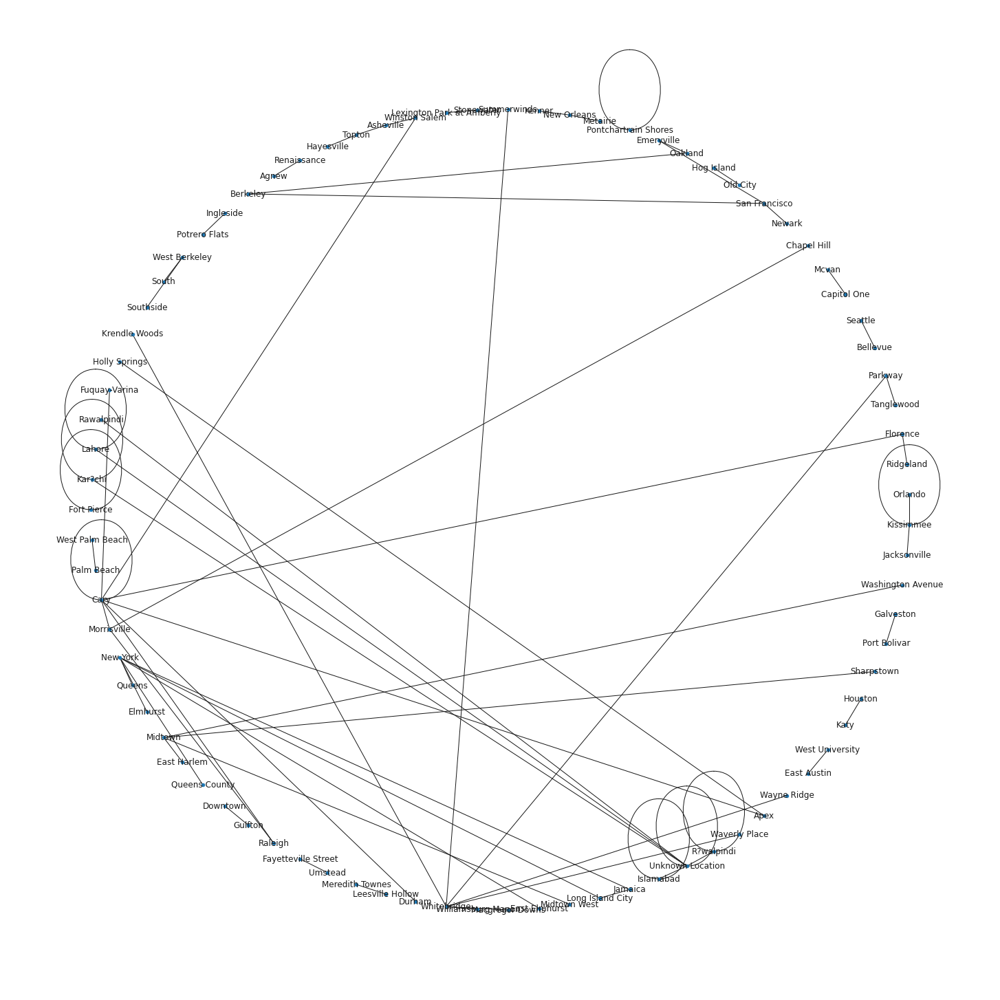

In [ ]:
g2 = nx.Graph()

g2 = nx.from_pandas_edgelist(Rides[Rides['PURPOSE*'] == 'Meeting'], source = 'START*', target = 'STOP*')

plt.figure(figsize=(20, 20)) 

nx.draw_shell(g2, with_labels = True, node_size = 20)

plt.show()

# Data Analytics

In [ ]:
%matplotlib inline

import sys
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
import time
import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)

sns.set()
pal = sns.hls_palette(10,  h=.5 )
sns.set_palette(pal)

pd.set_option('display.float_format', lambda x: '%.4f' % x)

## Importing Data

In [ ]:
!curl -O https://s3.amazonaws.com/nyc-tlc/misc/uber_nyc_data.csv

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 1405M  100 1405M    0     0  32.2M      0  0:00:43  0:00:43 --:--:-- 31.0M


In [ ]:
df_uber = pd.read_csv('/content/uber_nyc_data.csv')

In [ ]:
df_uber.shape

(30925738, 6)

In [ ]:
df_uber = df_uber.iloc[:20000000, :]

## Check for Erroneous Data.

In [ ]:
# Check for Duplicate Rows

len(df_uber[df_uber.duplicated() == True])

0

In [ ]:
# Checking for Null values

df_uber.isnull().any()

id                 False
origin_taz         False
destination_taz     True
pickup_datetime    False
trip_distance       True
trip_duration       True
dtype: bool

In [ ]:
df_uber.isnull().sum() 

id                      0
origin_taz              0
destination_taz    816073
pickup_datetime         0
trip_distance          24
trip_duration          24
dtype: int64

In [ ]:
arr1 = df_uber.origin_taz.unique() 

In [ ]:
arr2 = df_uber.destination_taz.unique()

In [ ]:
set(arr2) - set(arr1)

{'18', nan}

* Let's check some of the data with Missing destination and try to predict destination based on the other features.

In [ ]:
df_uber[df_uber.destination_taz.isnull()].head()

,id,origin_taz,destination_taz,pickup_datetime,trip_distance,trip_duration
15,252596,6B,NaN,2014-09-01 17:00:00,11.6700,0:23:45
32,252613,9,NaN,2014-09-01 16:00:00,80.6900,1:59:37
63,252644,9,NaN,2014-09-01 18:00:00,23.0700,1:03:37
141,252722,9,NaN,2014-09-01 10:00:00,21.7300,0:41:12
148,252729,4B,NaN,2014-09-01 10:00:00,4.6200,0:14:55


In [ ]:
df38 = df_uber[df_uber.trip_duration.isnull() & df_uber.trip_distance.isnull()]

df38.shape

(24, 6)

```
There are 24 records with values missing for trip distance and duration, none of which are missing the destination.
```

In [ ]:
len(df_uber[(df_uber.trip_duration.isnull() == False) & (df_uber.trip_distance.isnull())])

0

```
All cases for which trip_duration is null match the cases for which trip_distance is also NULL.
```

## Parsing Date & Time

In [ ]:
len(df_uber[df_uber.pickup_datetime.apply(lambda x: x[-5:] == '00:00') == False])

0

```
None of the pickup time data offer Minutes or Seconds precision. 
```

In [ ]:
def dateParser(s):

    """
    This Function takes a string in the format yyyy-mm-dd hh:mm:ss, and
    returns the same as a datetime object.
    """

    return datetime.datetime(int(s[0:4]), int(s[5:7]), int(s[8:10]), int(s[11:13]))

In [ ]:
# Apply parser to data

df_uber['pu_date_hour'] = df_uber.pickup_datetime.apply(dateParser)

In [ ]:
beginning = df_uber.pu_date_hour.min()

end = df_uber.pu_date_hour.max()

print ("Begining : ", beginning, "\n\nEnd :", end , "\n\nNo of Days :", end - beginning) 

Begining :  2014-09-01 00:00:00 

End : 2015-05-31 23:00:00 

No of Days : 272 days 23:00:00


```
Data encompasses 272 days from Sept 1st, 2014 to May 31, 2015
```

## Drop Duplicates

In [ ]:
# Drop Repeated Columns

df_uber = df_uber.drop('pickup_datetime', axis=1)

## Getting Federal Holidays

In [ ]:
from pandas.tseries.holiday import USFederalHolidayCalendar

holidays = USFederalHolidayCalendar().holidays(beginning, end, return_name = True) 

holidays

2014-09-01                     Labor Day
2014-10-13                  Columbus Day
2014-11-11                  Veterans Day
2014-11-27                  Thanksgiving
2014-12-25                     Christmas
2015-01-01                 New Years Day
2015-01-19    Martin Luther King Jr. Day
2015-02-16                Presidents Day
2015-05-25                  Memorial Day
dtype: object

In [ ]:
# Extracting the weekday for each holiday

holidays.index.map(lambda x: x.strftime('%a'))

Index(['Mon', 'Mon', 'Tue', 'Thu', 'Thu', 'Thu', 'Mon', 'Mon', 'Mon'], dtype='object')

In [ ]:
# Adding the Day Before and After the Holidays

holidays_all = (pd.concat([holidays, "Day After " + holidays.shift(1, 'D'), "Day Before " + holidays.shift(-1, 'D')])).sort_index()

holidays_all.head()

2014-08-31       Day Before Labor Day
2014-09-01                  Labor Day
2014-09-02        Day After Labor Day
2014-10-12    Day Before Columbus Day
2014-10-13               Columbus Day
dtype: object

## Extracting Date

In [ ]:
df_uber['pu_date'] = pd.Series(map(lambda x: x.astype('datetime64[D]'), df_uber['pu_date_hour'].values))

## Extracting Month & Year

In [ ]:
df_uber['year'] = df_uber['pu_date_hour'].dt.year

df_uber['month'] = df_uber['pu_date_hour'].dt.month

## Extracting Day

In [ ]:
df_uber['day'] = df_uber['pu_date_hour'].dt.day

## Extracting Hour

In [ ]:
df_uber['hour'] = df_uber['pu_date_hour'].dt.hour

## Extracting Week Day

In [ ]:
df_uber['weekday'] = df_uber['pu_date_hour'].dt.dayofweek

In [ ]:
df_uber.weekday.value_counts() 

5    3385271
4    3151795
3    3010357
2    2801680
6    2763431
1    2566203
0    2321263
Name: weekday, dtype: int64

## Transforming Trip Duration Data

In [ ]:
uniq_dur = df_uber[df_uber.trip_duration.isnull() == False].trip_duration.unique()

* Among unique duration strings, finding how many represent >= 10 H of duration


In [ ]:
long_duration = [] 

for item in uniq_dur:

    if len(item) != 7:

        long_duration.append(item)

* Checking for the most unusual strings for trip duration so that some erroneous entries can be addressed. 

In [ ]:
for item in long_duration:

    if len(item) > 8:

        print(item)

172032:14:50
172032:39:03
136:25:12
172032:17:45
172032:19:27


In [ ]:
def duration_to_minutes(s):

    """
    Function that takes a string with the hh:mm:ss format and
    returns the integer equivalent of the total time in minutes, 
    or zero for missing values in a Pandas dataframe.
    """

    if pd.isnull(s):

        val = 0

    else:

        hms = s.split(':')

        val = int(hms[0])*60 + int(hms[1]) + int(hms[2])/60.0
        
    return val

* Transforming the trip duration string into trip duration in minutes.

In [ ]:
df_uber['duration_min'] = df_uber.trip_duration.apply(duration_to_minutes) 

## Replace Missing Values 

* Replace the missing values with mean distance and duration for respective origin-destination.

In [ ]:
# Getting the mean distance and duration for each origin-destination pair

df_DistDur = df_uber.groupby(['origin_taz', 'destination_taz'])[['trip_distance', 'duration_min']].mean()

In [ ]:
# Replacing the missing values with the average distance and duration for the respective origin-destination pair

for i in df38.index:

    orig = df_uber.loc[i, 'origin_taz']

    dest = df_uber.loc[i, 'destination_taz']

    df_uber.loc[i, 'trip_distance'] = df_DistDur.loc[orig, dest].trip_distance
    
    df_uber.loc[i, 'duration_min'] = df_DistDur.loc[orig, dest].duration_min

## Average speed for each Trip

In [ ]:
# Calculate average trip speed (mph) to help in understanding outliers (like trips with duration > 10 h)

df_uber['trip_mph_avg'] = df_uber.trip_distance/(df_uber.duration_min/60.0)

In [ ]:
# Checking whether the trip_distance and duration_min have been replaced, and trip speed has been calculated

df_uber.iloc[df38.index, :].head()

,id,origin_taz,destination_taz,trip_distance,trip_duration,pu_date_hour,pu_date,year,month,day,hour,weekday,duration_min,trip_mph_avg
15155317,39535,2A,11,3.9627,NaN,2015-04-25 12:00:00,2015-04-25,2015,4,25,12,5,19.9284,11.9307
15245057,1009076,2A,2A,1.3493,NaN,2015-04-26 01:00:00,2015-04-26,2015,4,26,1,6,10.8886,7.4351
16519652,15028665,2A,7C,9.0344,NaN,2015-04-29 21:00:00,2015-04-29,2015,4,29,21,2,30.2522,17.9183
17148253,22250173,2A,2A,1.3493,NaN,2015-04-12 02:00:00,2015-04-12,2015,4,12,2,6,10.8886,7.4351
17297563,23716998,2C,11,4.8528,NaN,2015-04-25 13:00:00,2015-04-25,2015,4,25,13,5,24.6084,11.8320


In [ ]:
# Drop Redundant trip_duration & pu_date_hour Columns

df_uber = df_uber.drop('trip_duration', axis=1)

df_uber = df_uber.drop('pu_date_hour', axis=1)

## Estimated Revenue Per Trip

In [ ]:
base_fare = 2.55

per_minute = 0.35

per_mile = 1.75

min_fare = 8

In [ ]:
# Local variables must be followed by @. Only for arithmetic, cannot use if statement.

df_uber['est_revenue'] = df_uber.eval('@base_fare + duration_min * @per_minute + trip_distance * @per_mile')

df_uber.loc[df_uber.est_revenue < 8, 'est_revenue'] = min_fare

# Visualization

In [ ]:
!pip install chart_studio
import matplotlib.mlab as mlab
import chart_studio.plotly as py
from matplotlib.ticker import FuncFormatter
from matplotlib.offsetbox import (OffsetImage, AnnotationBbox) 
from matplotlib.patches import Ellipse 

## Create dataframe 

* Create dataframe to be used for visualization with exactly 365 days of data, and max trip duration of 16h.

In [ ]:
df_viz =  df_uber[(df_uber.pu_date != datetime.date(2015, 9, 1))].copy()

In [ ]:
df_viz = df_viz[(df_viz.duration_min <= 960)].copy()

In [ ]:
def thousands_comma(x, pos):

    """
    Args are the value and tick position. 
    Returns number with thousands comma and no decimals.
    """
    
    return '{:,.0f}'.format(x) # New syntax for formatting

def thousands_format(x, pos):

    """
    Args are the value and tick position. 
    Returns number of thousands with one decimal, and K in lieu of 3 zeros.
    """

    return '{:.0f}{}'.format(x * 1e-3, 'K') # Old syntax: '%1.0fK' % (x * 1e-3)

def millions_format(x, pos):

    """
    Args are the value and tick position. 
    Returns number of millions with one decimal, and M in lieu of 6 zeros.
    """

    return '{:.1f}{}'.format(x * 1e-6, 'M') 

def millions_currency(x, pos):

    """
    Args are the value and tick position. 
    Returns number of millions with a $ sign, M in lieu of 6 zeros, and no decimals.
    """

    return '{}{:.0f}{}'.format('$', x * 1e-6, 'M')

def annotate_labels(ax, labels_list, **kwargs):

    """
    Function to automatically add labels on bar charts.
    It takes a plot axis, an ordered list of labels, and text kwargs.
    """

    (y_bottom, y_top) = ax.get_ylim() # Getting y-axis height to calculate label position from

    y_height = y_top - y_bottom
    
    rects = ax.patches

    for rect, label in zip(rects, labels_list):

        height = rect.get_height()

        p_height = (height / y_height) # Fraction of axis height taken up by this rectangle

        label_position = height + (y_height * 0.01)

        ax.text(rect.get_x() + rect.get_width()/2., label_position, label, kwargs)
        
    return None

In [ ]:
# Create a plotting dataframe with counts (number of trips) grouped by day

byDate = df_viz.groupby('pu_date')['id'].count() #365 complete entries

byDate.head()

pu_date
2014-09-01    31592
2014-09-02    41496
2014-09-03    46339
2014-09-04    53402
2014-09-05    59718
Name: id, dtype: int64

## Total Trips Per Day

* Create a plot with the total number of trips per day, highlighting some changepoints associated with major holidays and other weather and touristic/cultural events.

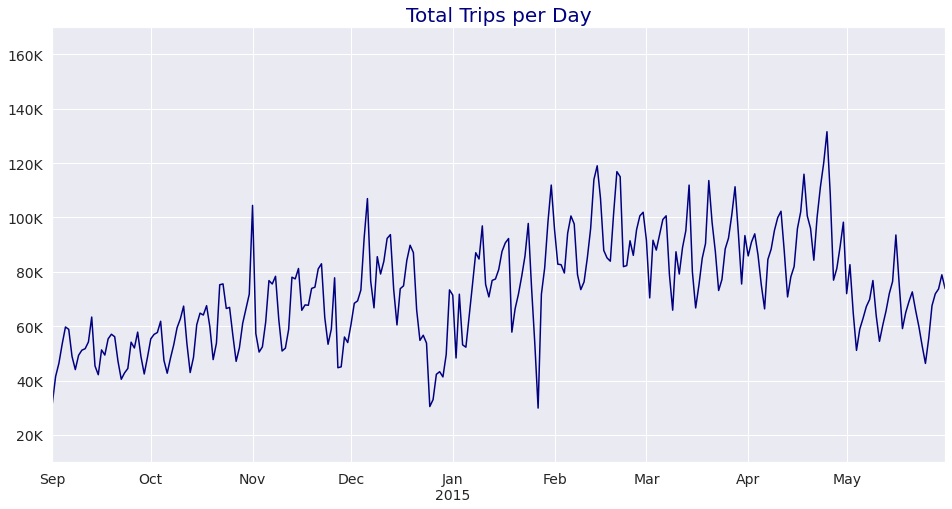

In [ ]:
fig = plt.figure()

ax = byDate.plot(figsize = (16, 8), fontsize = 12, ylim = (10000, 170000), color = 'navy')

formatter = FuncFormatter(thousands_format)

ax.yaxis.set_major_formatter(formatter)

plt.title('Total Trips per Day', fontsize= 20, color='navy')

plt.tick_params(labelsize=14)

plt.xlabel('')

plt.show()

## Total Number of Trips in Hours

* The effect of time on demand for Uber rides distribution per hour, weekday, and month.

In [ ]:
weekday_labels = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

month_labels = ['Sep', 'Oct', 'Nov', 'Dec', 'Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug']

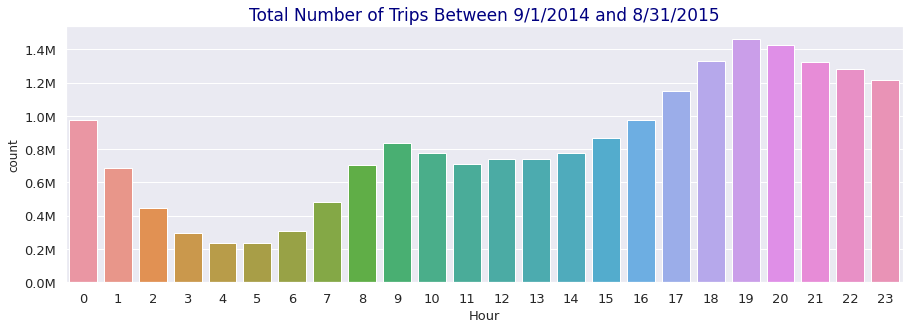

In [ ]:
# Create plots comparing demand per different time categories

fig = plt.figure(figsize = (15,16));

formatter = FuncFormatter(millions_format)

plt.subplot(3,1,1) ;

ax1 = sns.countplot(df_viz.hour, order = range(24))
ax1.yaxis.set_major_formatter(formatter)

plt.tick_params(labelsize=13)
plt.title('Total Number of Trips Between 9/1/2014 and 8/31/2015', fontsize=17, color='navy')
plt.xlabel('Hour', fontsize=13);

## Total Number of Trips in Weekdays

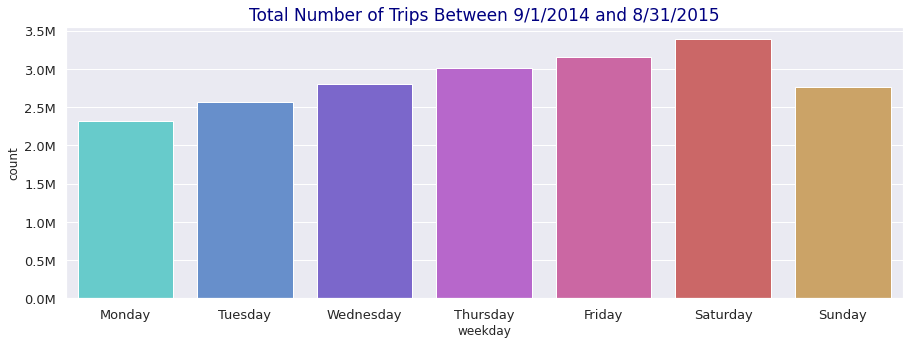

In [ ]:
fig = plt.figure(figsize = (15, 5));
formatter = FuncFormatter(millions_format);

ax2 = sns.countplot(df_viz.weekday, order = range(7));
ax2.set_xticklabels(weekday_labels);
ax2.yaxis.set_major_formatter(formatter);

plt.tick_params(labelsize=13);
plt.title('Total Number of Trips Between 9/1/2014 and 8/31/2015', fontsize=17, color='navy');

## Total Number of Trips in Month

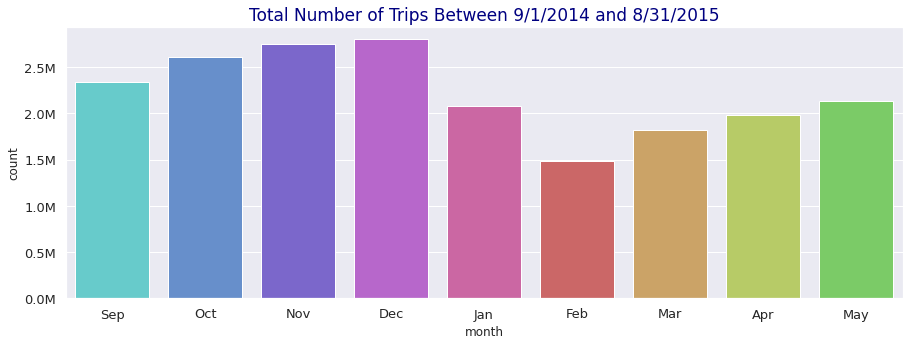

In [ ]:
fig = plt.figure(figsize = (15, 5));
formatter = FuncFormatter(millions_format);

ax3 = sns.countplot(df_viz.month);
ax3.set_xticklabels(month_labels);
ax3.yaxis.set_major_formatter(formatter);

plt.tick_params(labelsize=13);
plt.title('Total Number of Trips Between 9/1/2014 and 8/31/2015', fontsize=17, color='navy');

## Estimated Monthly Base Revenue

* How much was the NYC market worth in the period?

In [ ]:
# Create dataframe with grouped revenue data

byDateRev = df_viz.groupby('month')['est_revenue'].sum()

In [ ]:
# Estimate Uber's gross margin for the entire 1 year period based on 25% share of the base revenue.

sumRev = byDateRev.sum()

print ('Base Revenue : ${:,.0f}M'.format(sumRev * 1e-6), " \nUber's Base Gross Margin :", '${:,.0f}'.format(sumRev * .25))

Base Revenue : $382M  
Uber's Base Gross Margin : $95,386,565


## Total Base Revenue Per Month

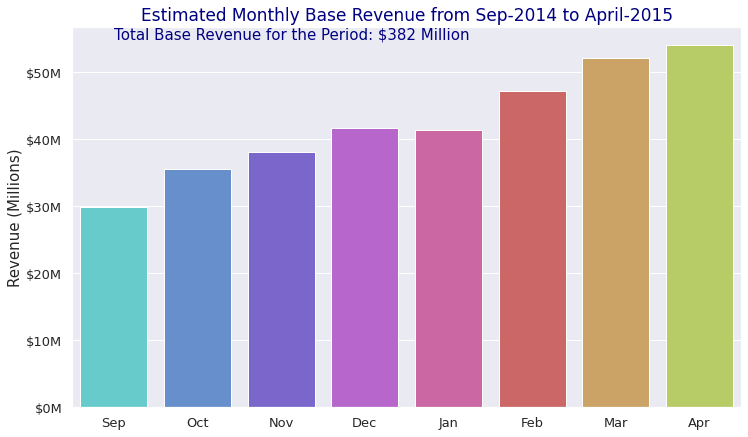

In [ ]:
months_seq = [9,10,11,12,1,2,3,4]

formatter = FuncFormatter(millions_currency)

plt.figure(figsize = (12, 7))

ax = sns.barplot(byDateRev.index, byDateRev.values, order = months_seq)

month = ['Sep', 'Oct', 'Nov', 'Dec', 'Jan', 'Feb', 'Mar', 'Apr']

ax.set_xticklabels(month)

ax.yaxis.set_major_formatter(formatter)

font = {'color': 'navy', 'size': 15} 

plt.text(0, 55000000, 'Total Base Revenue for the Period: ${:,.0f} Million'.format(sumRev * 1e-6),   fontdict = font)
plt.xlabel('')
plt.ylabel('Revenue (Millions)', fontsize = 15)

plt.tick_params(labelsize=13)
plt.title('Estimated Monthly Base Revenue from Sep-2014 to April-2015', fontsize = 17, color='navy')
plt.show()

* Mean fare from revenue estimate for the period

In [ ]:
df_viz.est_revenue.mean()

19.07736919831894

## Base Revenue Growth

* Month over Month Base Revenue Growth to figure out how fast has Uber grown in the period. 

In [ ]:
# Create dictionary with calculated month over month revenue percentage growth

dict_growth = {}

for i in range(len(months_seq)):

    mo = months_seq[i]

    rev = byDateRev[mo]

    if mo == 9:

        growth_pct = 0

    elif mo == 1:

        growth_pct = ((rev/byDateRev[12]) - 1) * 100

    else:

        growth_pct = ((rev/byDateRev[mo - 1]) - 1) * 100

    print(month_labels[i], 'Revenue :', '${:,.0f}'.format(rev), '\nGrowth % = ', '{:.1f}\n'.format(growth_pct))

    dict_growth[month_labels[i]] = growth_pct

Sep Revenue : $29,932,282 
Growth % =  0.0

Oct Revenue : $35,531,001 
Growth % =  18.7

Nov Revenue : $38,170,687 
Growth % =  7.4

Dec Revenue : $41,661,569 
Growth % =  9.1

Jan Revenue : $41,457,151 
Growth % =  -0.5

Feb Revenue : $47,252,852 
Growth % =  14.0

Mar Revenue : $52,154,385 
Growth % =  10.4

Apr Revenue : $54,095,067 
Growth % =  3.7



## Total Cummulative Growth

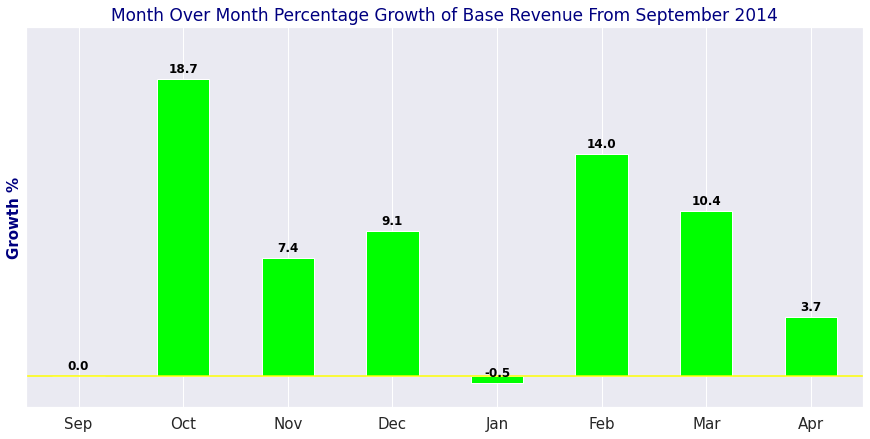

In [ ]:
df_plt1 = pd.DataFrame(pd.Series(dict_growth), index = ['Sep', 'Oct', 'Nov', 'Dec', 'Jan', 'Feb', 'Mar', 'Apr'], columns = ['growth_pct'])

labels_list = df_plt1.growth_pct.values.round(1)

kwargs = {'fontsize': 12, 'ha':'center', 'va': 'bottom', 'weight': 'bold', 'color': 'black'}

ax = df_plt1.plot(kind = 'bar', figsize = (15,7), fontsize = 14, rot = 0, legend=False, color='lime') 

ax.get_yaxis().set_ticks([])

annotate_labels(ax, labels_list, **kwargs)

plt.axhline(0, color='yellow')

plt.title('Month Over Month Percentage Growth of Base Revenue From September 2014', fontsize = 17, color='navy')

plt.ylabel('Growth %', fontsize = 15, weight='bold', color='navy')

plt.ylim(-2, 22)

plt.tick_params(labelsize=15)

plt.show()

## Cummulative Base Revenue Growth

In [ ]:
print('Cummulative % Growth Over Period :', df_plt1.growth_pct.sum())

Cummulative % Growth Over Period : 62.86265477638046


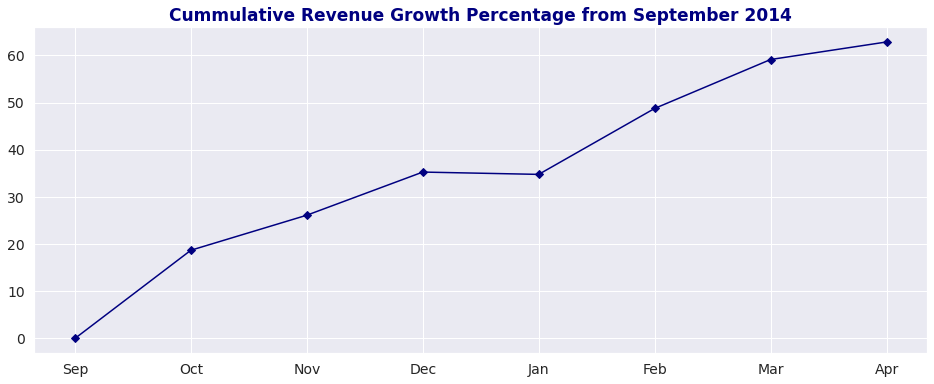

In [ ]:
df_plt1.cumsum().plot(color = 'navy', marker = 'D', legend = False, figsize=(16, 6))

plt.title('Cummulative Revenue Growth Percentage from September 2014', fontsize=17, weight='bold', color='navy')

plt.tick_params(labelsize=14)

plt.show();

## Traffic Analysis

* Finding out which day of the week has the worst (slowest) traffic overall?

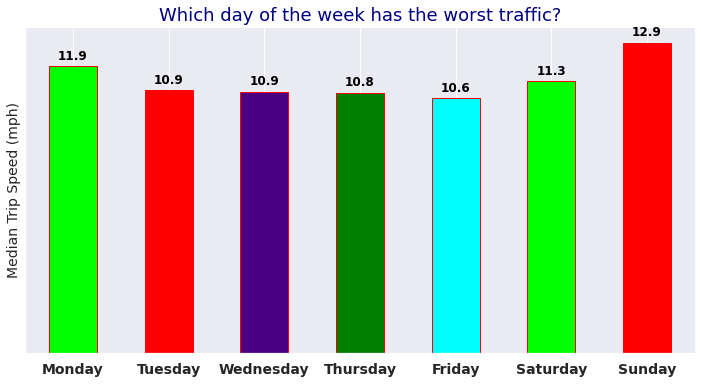

In [ ]:
df_plt2 = df_viz.groupby('weekday')['trip_mph_avg'].median() 

# Create plot. Does Saturday have better traffic flow than Monday?

fig = plt.figure()

labels_list = df_plt2.values.round(1)

kwargs = {'fontsize': 12, 'ha':'center', 'va': 'bottom', 'weight': 'bold', 'color': 'black'}

ax = df_plt2.plot(kind='bar', rot = 0, figsize = (12, 6), fontsize = 12, edgecolor='red', linewidth=1, color=['lime', 'red','indigo', 'green', 'cyan'])

ax.set_xticklabels(weekday_labels, weight='bold')

ax.get_yaxis().set_ticks([])

annotate_labels(ax, labels_list, **kwargs)

plt.xlabel('')

plt.ylabel('Median Trip Speed (mph)', fontsize = 14)

plt.tick_params(labelsize=14)

plt.title('Which day of the week has the worst traffic?', fontsize = 18, color='navy')

plt.show()

## Median Distance Traveled Per Trip

* What is the median distance traveled per trip? Are there any insights we can learn from it?

### Week Ends 

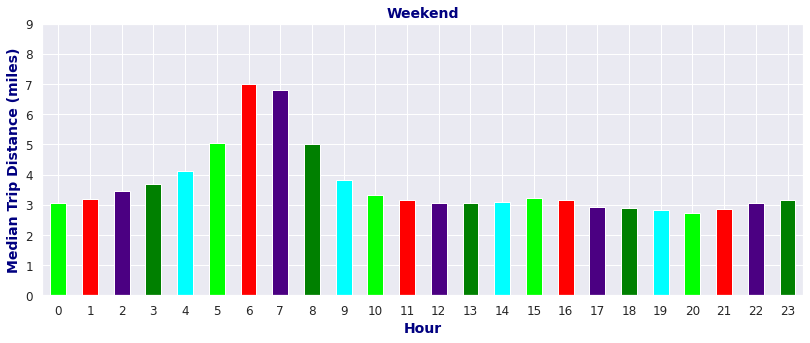

In [ ]:
plt.figure(figsize = (30, 5))

plt.subplot(1,2,1)

df_viz[(df_viz.weekday >= 5)].groupby('hour')['trip_distance'].median().plot(kind='bar', rot = 0, fontsize=14, color=['lime', 'red','indigo', 'green', 'cyan'])

plt.ylim(0, 9)

plt.tick_params(labelsize=12)

plt.ylabel('Median Trip Distance (miles)', fontsize=14, weight='bold', color='navy')

plt.xlabel('Hour', fontsize=14, weight='bold', color='navy')

plt.title('Weekend', fontsize=14, weight='bold', color='navy')

plt.show()

### Week Days

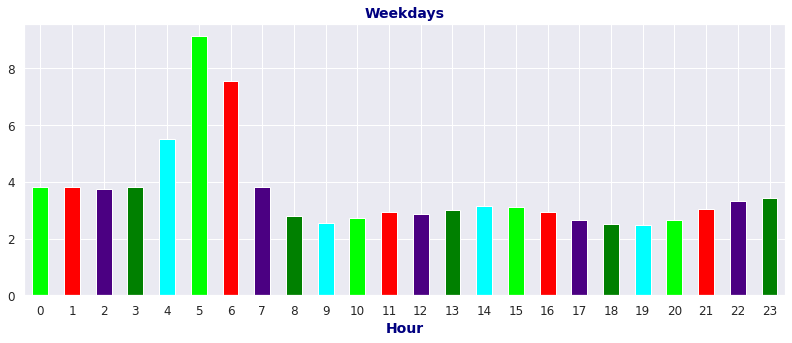

In [ ]:
plt.figure(figsize = (30, 5))

plt.subplot(1,2,2)

df_viz[df_viz.weekday < 5].groupby('hour')['trip_distance'].median().plot(kind='bar', rot = 0, color=['lime', 'red','indigo', 'green', 'cyan'])

plt.tick_params(labelsize=12)

plt.xlabel('Hour', fontsize=14, weight='bold', color='navy')

plt.title('Weekdays', fontsize=14, weight='bold', color='navy')

plt.show()

## Count of Trips Per Hour

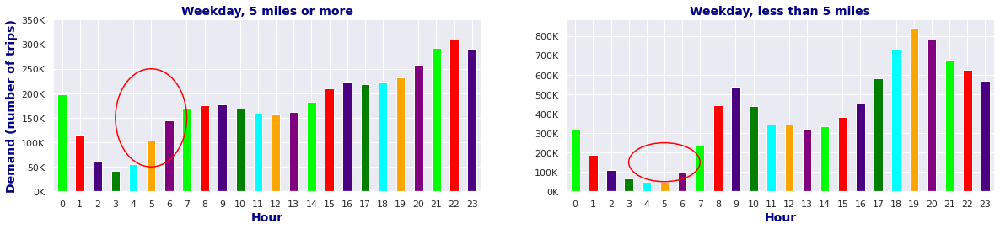

In [ ]:
fig = plt.figure(figsize = (20, 9))

formatter = FuncFormatter(thousands_format)

plt.subplot(2,2,1)

ax1 = df_viz[(df_viz.weekday < 5) & (df_viz.trip_distance >= 5)].\
groupby('hour')['trip_distance'].count().plot(kind='bar', rot = 0,color=['lime', 'red','indigo', 'green', 'cyan','orange','purple'] )

ax1.yaxis.set_major_formatter(formatter)

ellipse = Ellipse(xy=(5, 150000), width=4, height=200000, edgecolor='red', fc='None', lw=1.5)

ax1.add_patch(ellipse)

plt.xlabel('Hour', fontsize=14, weight='bold', color='navy')

plt.ylabel('Demand (number of trips)', fontsize=14, weight='bold', color='navy')

plt.ylim(0, 350000)

plt.title('Weekday, 5 miles or more', fontsize=14, weight='bold', color='navy')


plt.subplot(2,2,2)

ax2 = df_viz[(df_viz.weekday < 5) & (df_viz.trip_distance < 5)].\
groupby('hour')['trip_distance'].count().plot(kind='bar', rot = 0,color=['lime', 'red','indigo', 'green', 'cyan','orange','purple'])

ax2.yaxis.set_major_formatter(formatter)

ellipse = Ellipse(xy=(5, 150000), width=4, height=200000, edgecolor='red', fc='None', lw=1.5)

ax2.add_patch(ellipse)

plt.xlabel('Hour', fontsize=14, weight='bold', color='navy')

plt.title('Weekday, less than 5 miles', fontsize=14, weight='bold', color='navy')

fig.subplots_adjust(hspace=0.4)

fig.subplots_adjust(hspace=0.4)

plt.show()

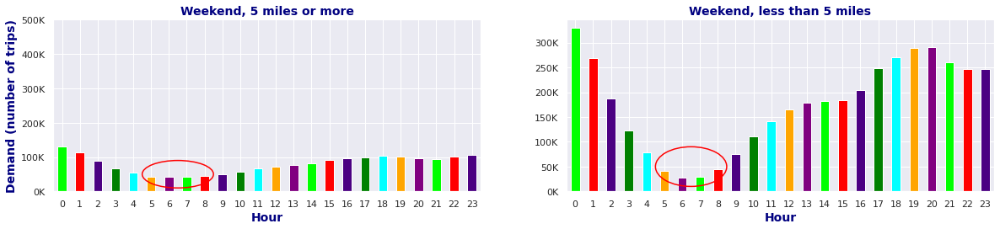

In [ ]:
fig = plt.figure(figsize = (20, 9))

formatter = FuncFormatter(thousands_format)

plt.subplot(2,2,4)

ax4 = df_viz[(df_viz.weekday >= 5) & (df_viz.trip_distance < 5)].\
groupby('hour')['trip_distance'].count().plot(kind='bar', rot = 0,color=['lime', 'red','indigo', 'green', 'cyan','orange','purple'])

ax4.yaxis.set_major_formatter(formatter)

ellipse = Ellipse(xy=(6.5, 50000), width=4, height=80000, edgecolor='red', fc='None', lw=1.5)

ax4.add_patch(ellipse)

plt.xlabel('Hour', fontsize=14, weight='bold', color='navy')

plt.title('Weekend, less than 5 miles', fontsize=14, weight='bold', color='navy')


plt.subplot(2,2,3)

ax3 = df_viz[(df_viz.weekday >= 5) & (df_viz.trip_distance >= 5)].\
groupby('hour')['trip_distance'].count().plot(kind='bar', rot = 0,color=['lime', 'red','indigo', 'green', 'cyan','orange','purple'])

ax3.yaxis.set_major_formatter(formatter)

ellipse = Ellipse(xy=(6.5, 50000), width=4, height=80000, edgecolor='red', fc='None', lw=1.5)

ax3.add_patch(ellipse)

plt.xlabel('Hour', fontsize=14, weight='bold', color='navy')

plt.ylabel('Demand (number of trips)', fontsize=14, weight='bold', color='navy')

plt.ylim(0, 500000)

plt.title('Weekend, 5 miles or more', fontsize=14, weight='bold', color='navy')

fig.subplots_adjust(hspace=0.4)

plt.show()

## Pickup and Drop - Off Zones

* Find the most popular pickup and drop-off taxi zones.

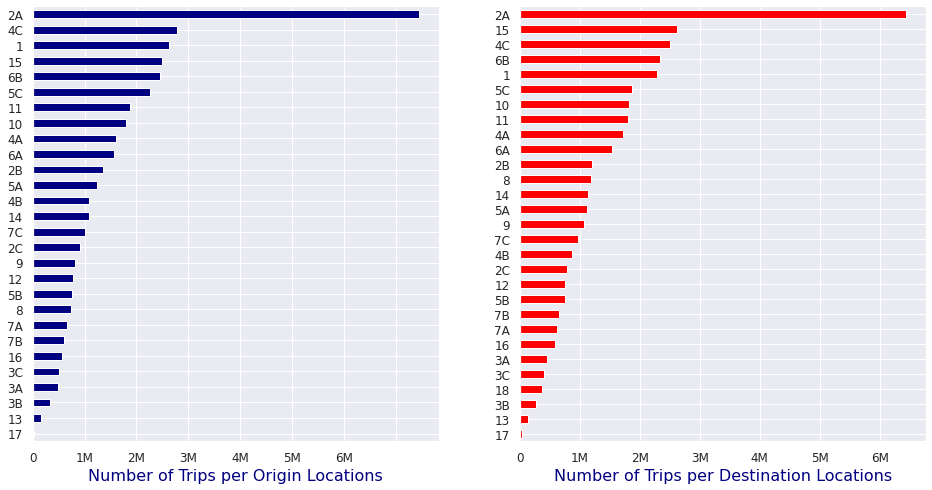

In [ ]:
fig = plt.figure(figsize = (16,8))

plt.subplot(1,2,1)

ax1 = df_viz.origin_taz.value_counts(ascending = True).plot(kind = 'barh', color = 'navy')

ax1.set_xticklabels(['0', '1M', '2M', '3M', '4M', '5M', '6M'])

plt.tick_params(labelsize=12)

plt.xlabel('Number of Trips per Origin Locations', fontsize = 16, color='navy')

plt.subplot(1,2,2) 

ax2 = df_viz.destination_taz.value_counts(ascending = True).plot(kind = 'barh', color = 'red')

ax2.set_xticklabels(['0', '1M', '2M', '3M', '4M', '5M', '6M'])

plt.tick_params(labelsize=12)

plt.xlabel('Number of Trips per Destination Locations', fontsize = 16, color='navy')

plt.show()

## Top 5 Origins/Destinations

* Percentage of trips represented by the top five origins/destinations

In [ ]:
print(df_viz.origin_taz.value_counts().head(5).sum()/float(len(df_viz))) 

print(df_viz.destination_taz.value_counts().head(5).sum()/float(len(df_viz[df_viz.destination_taz.isnull() == False])))

0.44488926242332416
0.42195130024564903


## Total Pickups or Drop-offs

* Total pickups or drop-offs within any combination of the top 5 locations. 

In [ ]:
len(df_viz[(df_viz.origin_taz.isin(['2A', '15', '4C', '1', '6B']) == True) & (df_viz.destination_taz.isin(['2A', '15', '4C', '1', '6B']) == True)])

4110665

* Percentage of all trips start or finish at 2A

In [ ]:
len(df_viz[(df_viz.origin_taz == '2A') | (df_viz.destination_taz == '2A')])/(1.0*len(df_viz))

0.29919203261649624

## Heat Map of Pick Up and Drop Off

* Most popular pick up and drop off location pairs

In [ ]:
df_plt3 = df_viz.pivot_table('id', aggfunc='count', index='origin_taz', columns='destination_taz')

findfont: Font family ['Tahoma'] not found. Falling back to DejaVu Sans.


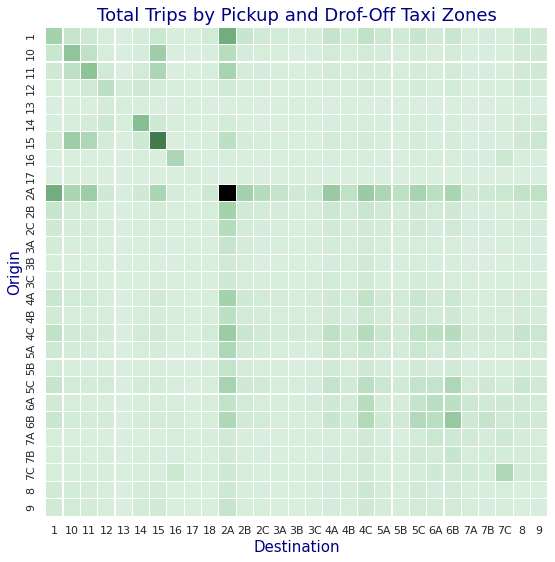

In [ ]:
fig = plt.figure(figsize=(9,9))

cmap = sns.cubehelix_palette(8, start=2, rot=0, dark=0, light=.9, as_cmap=True) #'YlOrRd' #ggplot:'viridis'

sns.heatmap(df_plt3, cmap=cmap, linewidths=0.1, cbar=False)

plt.title('Total Trips by Pickup and Drof-Off Taxi Zones', fontsize=18, color='navy')

plt.xlabel('Destination', fontsize=15, fontname='Tahoma', color='navy')

plt.ylabel('Origin', fontsize=15, fontname='Tahoma', color='navy')

plt.tick_params(labelsize=11)

plt.show()

## Mean Distance to Destination

* Mean distance to destination from the most popular pick up location

In [ ]:
df_plt4 = df_viz[df_viz.origin_taz == '2A'].groupby('destination_taz')['trip_distance'].mean().sort_values()

df_plt5 = df_viz[df_viz.origin_taz == '2A'].groupby('destination_taz')['duration_min'].mean().sort_values()

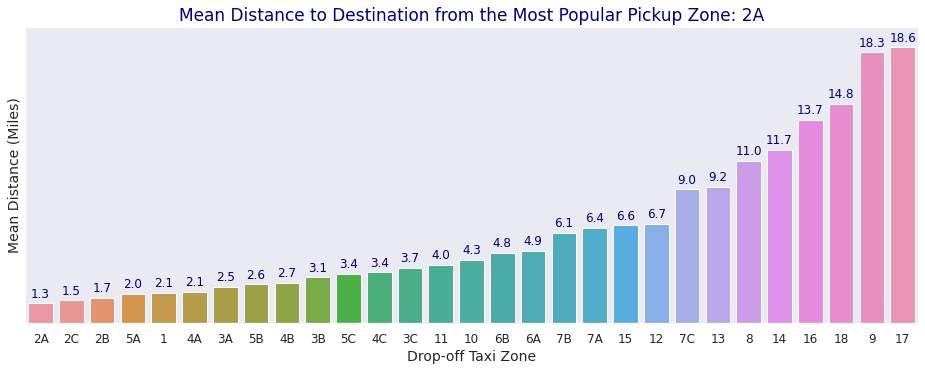

In [ ]:
fig = plt.figure(figsize = (16,12))

kwargs = {'fontsize': 12, 'ha':'center', 'va': 'bottom', 'color': 'navy'}

plt.subplot(2,1,1)

ax1 = sns.barplot(x=df_plt4.index, y=df_plt4.values)

ax1.set_yticks(range(0, 21, 2))

ax1.get_yaxis().set_ticks([])

labels_list = df_plt4.values.round(1)

annotate_labels(ax1, labels_list, **kwargs)

plt.title('Mean Distance to Destination from the Most Popular Pickup Zone: 2A', fontsize=17, color='navy')

plt.ylabel('Mean Distance (Miles)', fontsize = 14)

plt.xlabel('Drop-off Taxi Zone', fontsize=14)

plt.tick_params(labelsize=12)

plt.show()

## Mean Time to Destination

* Mean Time to destination from the most popular pick up location

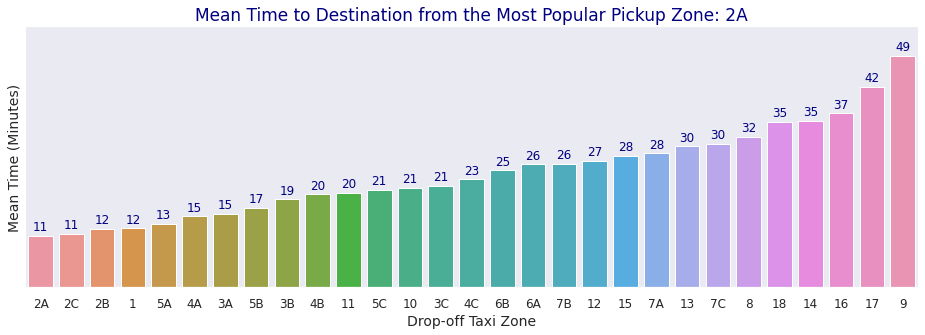

In [ ]:
fig = plt.figure(figsize = (16,12))

kwargs = {'fontsize': 12, 'ha':'center', 'va': 'bottom', 'color': 'navy'}

plt.subplot(2,1,2)

ax2 = sns.barplot(x=df_plt5.index, y=df_plt5.values)

ax2.set_yticks(range(0, 51, 5))

ax2.get_yaxis().set_ticks([])

labels_list = df_plt5.apply(lambda x: '{:.0f}'.format(round(x))).values

annotate_labels(ax2, labels_list, **kwargs)

plt.title('Mean Time to Destination from the Most Popular Pickup Zone: 2A', fontsize=17, color='navy')

plt.ylabel('Mean Time (Minutes)', fontsize = 14)

plt.ylim(0,55)

plt.xlabel('Drop-off Taxi Zone', fontsize=14)

plt.tick_params(labelsize=12)

fig.subplots_adjust(hspace=.5)

## Histograms of Distance and Duration

* Distribution of trip duration next to the histogram of trip distance for comparison.

In [ ]:
df_viz.trip_distance.max(), df_uber.trip_distance.max()

freq, bins_dist = np.histogram(df_viz.trip_distance, bins=10, range=(0, 25))

freq, bins_dur = np.histogram(df_viz.duration_min, bins=10, range=(0, 50))

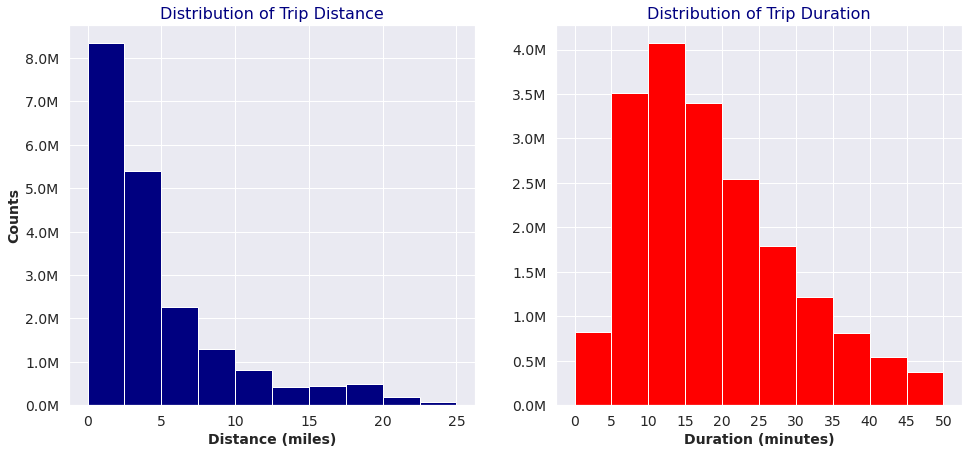

In [ ]:
fig = plt.figure(figsize=(16, 7))

formatter = FuncFormatter(millions_format)

plt.subplot(1,2,1)

ax1 = df_viz.trip_distance.dropna().hist(bins=bins_dist, color ='navy')

ax1.yaxis.set_major_formatter(formatter)

plt.xlabel('Distance (miles)', fontsize=14, weight='bold')

plt.ylabel('Counts', fontsize=14, weight='bold')

plt.tick_params(labelsize=14)

plt.title('Distribution of Trip Distance', color='navy', fontsize=16)


plt.subplot(1,2,2)

ax2 = df_viz.duration_min.hist(bins=bins_dur, color ='red')

ax2.yaxis.set_major_formatter(formatter)

ax2.set_xticks(bins_dur) 

plt.xlabel('Duration (minutes)', fontsize=14, weight='bold')

plt.ylabel('')

plt.tick_params(labelsize=14)

plt.title('Distribution of Trip Duration', color='navy', fontsize=16)

plt.show()

## Trip Distance vs Trip Duration

findfont: Font family ['Tahoma'] not found. Falling back to DejaVu Sans.


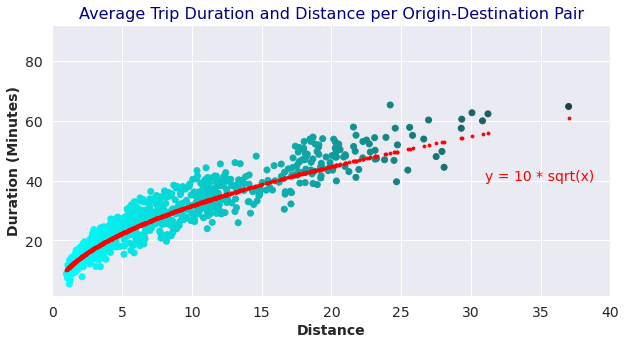

In [ ]:
df_plt6 = df_viz.groupby(['origin_taz', 'destination_taz'])['trip_distance', 'duration_min'].mean()

distance = df_plt6.values[:,:1]

duration = df_plt6.values[:,1:]

duration_hat = pd.Series(distance.reshape(812,)).apply(lambda x: 10*np.sqrt(x))

plt.figure(figsize = (10,5));

cmap = sns.dark_palette('cyan', 3, reverse = True, as_cmap=True)

plt.scatter(distance, duration, c=distance, cmap= cmap) 

plt.scatter(distance, duration_hat, color='red', s=8)

font = {'color': 'red', 'size': 14, 'family': 'Tahoma'}

plt.text(31, 40, 'y = 10 * sqrt(x)', fontdict = font);

plt.xlim(0, 40)

plt.xlabel('Distance', fontsize = 14, weight='bold')

plt.ylabel('Duration (Minutes)', fontsize = 14, weight='bold')

plt.tick_params(labelsize=14)

plt.title('Average Trip Duration and Distance per Origin-Destination Pair', fontsize = 16, color='navy')

plt.show();

## Average Speed Per Trip

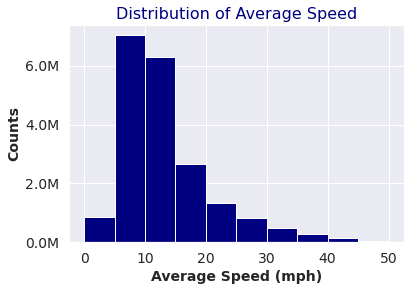

In [ ]:
freq, bins = np.histogram(df_viz.trip_mph_avg, bins=10, range=(0, 50))

fig, ax = plt.subplots(1,1)

formatter = FuncFormatter(millions_format)

ax.hist(df_viz.trip_mph_avg.dropna(), bins, color = 'navy')

ax.yaxis.set_major_formatter(formatter)

plt.xlabel('Average Speed (mph)', fontsize=14, weight='bold')

plt.ylabel('Counts', fontsize=14, weight='bold')

plt.tick_params(labelsize=14)

plt.title('Distribution of Average Speed', color='navy', fontsize=16)

plt.show();

## Average Speed Per Hour 

* Average Speed Per Hour during Weekdays

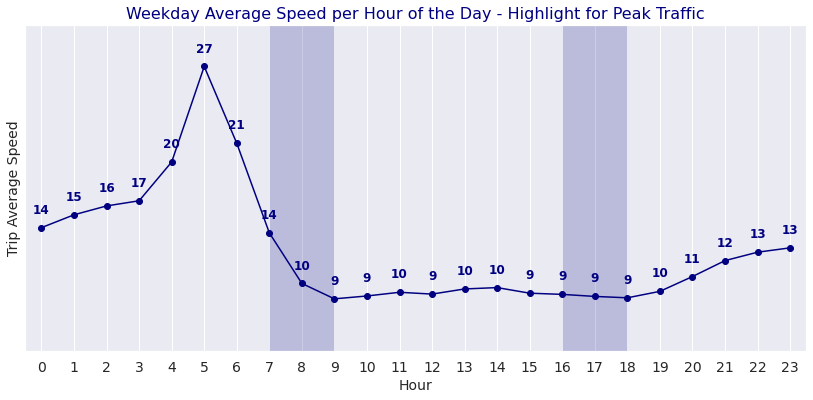

In [ ]:
df_plt7 = df_viz[df_viz.weekday < 5].groupby('hour')['trip_mph_avg'].median()

plt.figure(figsize =(14, 6))

kwargs = {'fontsize': 12, 'ha':'center', 'va': 'top', 'color': 'navy', 'weight': 'bold'}

ax = df_plt7.plot(marker = 'o', color = 'navy')

for x, y in zip(df_plt7.index, df_plt7.values):

    ax.annotate('{:.0f}'.format(y), xy=(x, y), xytext= (0, 24), textcoords='offset points', **kwargs)

ax.get_yaxis().set_ticks([]) 

plt.fill([7,9,9,7], [0,0,30,30], 'navy', alpha=0.2)

plt.fill([16,18,18,16], [0,0,30,30], 'navy', alpha=0.2)

plt.xticks(range(24))

plt.xlabel('Hour', fontsize=14)

plt.ylabel('Trip Average Speed', fontsize=14)

plt.ylim(5, 30)
plt.xlim(-0.5, 23.5)

plt.tick_params(labelsize=14)

plt.title('Weekday Average Speed per Hour of the Day - Highlight for Peak Traffic', fontsize = 16, color='navy')

plt.show()

## Average Trips Per Month 

* Trips per month during peak hours and off-peak hours

In [ ]:
def is_peak_hour(x):

    """ 
    Function that takes an array(x) with two integers representing 
    hour of the day and weekday, respectively, and
    returns 1 if it's peak hour as defined, 0 otherwise.
    """
    
    return 1 if x[0] in (7,8,9,16,17,18) and x[1] < 5 else 0

In [ ]:
df_viz['peak_hour'] = pd.Series(map(lambda x: is_peak_hour(x), df_viz.loc[:, ['hour', 'weekday']].values))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  del sys.path[0]


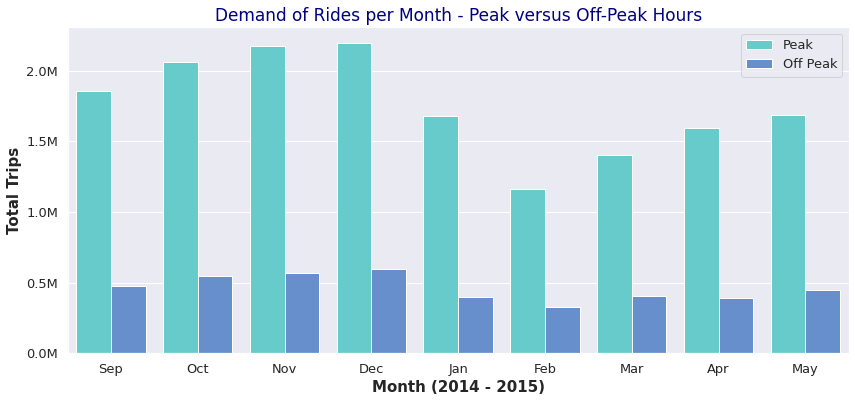

In [ ]:
plt.figure(figsize = (14, 6))

formatter = FuncFormatter(millions_format);

ax = sns.countplot(df_viz['month'], hue = df_viz['peak_hour']);

ax.set_xticklabels(month_labels);

ax.yaxis.set_major_formatter(formatter);

handles, labels = ax.get_legend_handles_labels();

plt.legend(handles, labels=['Peak', 'Off Peak'], loc='best', fontsize=13);

plt.tick_params(labelsize=13);

plt.xlabel('Month (2014 - 2015)', fontsize = 15, weight='bold');

plt.ylabel('Total Trips', fontsize = 15, weight='bold');

plt.title('Demand of Rides per Month - Peak versus Off-Peak Hours', fontsize = 17, color='navy');

plt.show();